In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.7.2 anndata==0.7.5 umap==0.5.1 numpy==1.19.5 scipy==1.6.2 pandas==1.1.5 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [3]:
results_file = 'write/220301_lung_cancer_myeloids_analysis.h5ad'

In [4]:
adata = sc.read_h5ad(
    '/mnt/d/Nishino/DRY/data/analysis/Omar_san/220224_lung_cancer_scanpy/write/220301_myeloids.h5ad')     

In [5]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


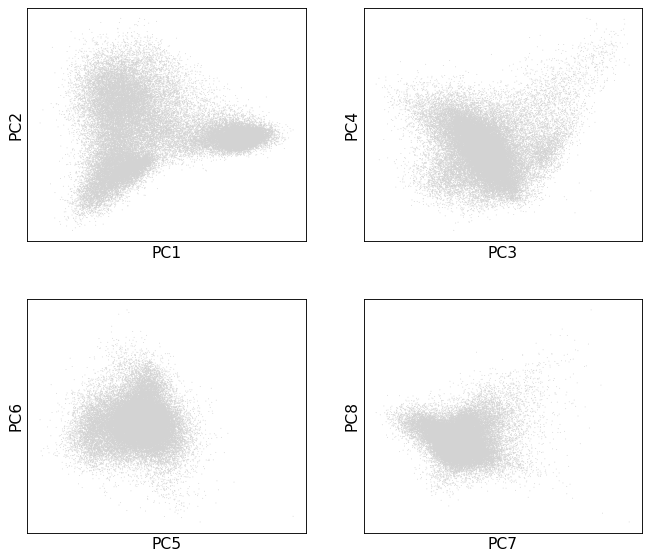

In [6]:
sc.pl.pca(adata, components = ['1,2','3,4','5,6','7,8'], ncols=2)

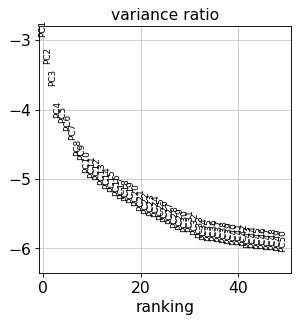

In [7]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs = 50)

In [8]:
sc.pp.neighbors(adata, n_pcs = 40, n_neighbors = 5)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


In [9]:
sc.tl.leiden(adata, resolution = 0.2, key_added = "leiden_0.2")
sc.tl.leiden(adata, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(adata, resolution = 0.6, key_added = "leiden_0.6")
sc.tl.leiden(adata, resolution = 0.8, key_added = "leiden_0.8")
sc.tl.leiden(adata, resolution = 1.0, key_added = "leiden_1.0")
sc.tl.leiden(adata, resolution = 1.2, key_added = "leiden_1.2")

running Leiden clustering
    finished: found 13 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 25 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 32 clusters and added
    'leiden_0.8', the cluster labels (adata.obs, categorical) (0:00:03)
running Leiden clustering
    finished: found 37 clusters and added
    'leiden_1.0', the cluster labels (adata.obs, categorical) (0:00:04)
running Leiden clustering
    finished: found 41 clusters and added
    'leiden_1.2', the cluster labels (adata.obs, categorical) (0:00:03)


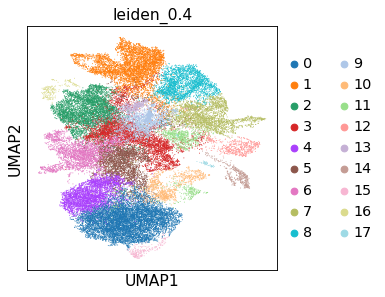

In [10]:
sc.pl.umap(adata, color='leiden_0.4')

In [11]:
adata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,leiden_0.6,leiden_0.2,leiden_0.4,leiden_0.8,leiden_1.0,leiden_1.2
AAACCTGAGACAAAGG_LUNG_N18,1100,2990.0,133.0,4.448161,1100,2990.0,1,2,1,2,0,7
AAACCTGAGACGACGT_LUNG_T09,2348,10807.0,408.0,3.775331,2348,10807.0,3,4,12,21,22,22
AAACCTGAGAGCAATT_LUNG_N31,1283,5095.0,123.0,2.414132,1283,5095.0,1,2,1,2,0,2
AAACCTGAGAGCCTAG_LUNG_N20,1942,9094.0,458.0,5.036288,1942,9094.0,2,0,4,3,1,1
AAACCTGAGAGGGATA_NS_19,1639,6933.0,360.0,5.192557,1639,6932.0,4,2,3,20,21,17
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCGGTCTAA_NS_17,766,2033.0,209.0,10.280374,766,2033.0,3,4,7,22,23,24
TTTGTCATCTCAAACG_LN_12,4004,28116.0,1420.0,5.050505,4004,28116.0,21,10,6,27,31,35
TTTGTCATCTGCAGTA_LUNG_N31,1049,3610.0,188.0,5.207756,1049,3610.0,3,2,1,9,0,17
TTTGTCATCTGCGTAA_LUNG_N08,2219,9919.0,1030.0,10.384111,2219,9919.0,0,0,0,0,3,4


In [12]:
adata.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm,mean,std
A2M,False,18910,0.433177,90.930717,90320.0,18910,True,0.482349,3.639923,4.248675,-1.652408e-11,0.503457
A2M-AS1,False,3250,0.016455,98.441292,3431.0,3250,True,0.050549,1.505685,0.778857,2.615934e-12,0.178330
AARD,False,1753,0.015146,99.159257,3158.0,1753,True,0.017604,1.694605,1.179015,-9.913722e-12,0.100642
AATK,False,2592,0.015223,98.756870,3174.0,2592,True,0.023510,1.636142,1.055182,-6.230972e-12,0.115632
ABCA1,False,20542,0.176738,90.148005,36851.0,20542,True,0.197540,1.467033,0.696985,2.040381e-11,0.341059
...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF699,False,3843,0.018906,98.156888,3942.0,3843,True,0.049030,1.398352,0.551511,-1.444433e-11,0.174446
ZNF791,False,27773,0.157516,86.680000,32843.0,27773,True,0.303893,1.431406,0.621523,5.093652e-12,0.438168
ZNF80,False,773,0.004201,99.629267,876.0,773,True,0.017121,1.843429,1.494246,2.772262e-12,0.102800
ZNF831,False,2163,0.010594,98.962620,2209.0,2163,True,0.036099,1.485847,0.736836,6.675175e-13,0.151081


In [13]:
adata_lungN = adata[adata.obs_names.str.contains('LUNG_N'),:]

In [14]:
adata_lungN

View of AnnData object with n_obs × n_vars = 16750 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [15]:
adata_lungT = adata[adata.obs_names.str.contains('LUNG_T'),:]

In [16]:
adata_lungT

View of AnnData object with n_obs × n_vars = 8630 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [17]:
adata_EBUS = adata[adata.obs_names.str.contains('EBUS'),:]

In [18]:
adata_EBUS

View of AnnData object with n_obs × n_vars = 5361 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

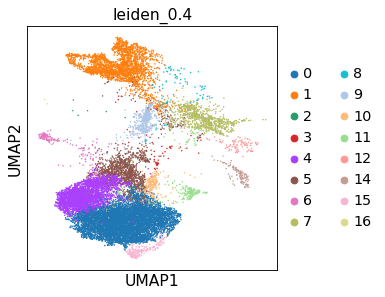

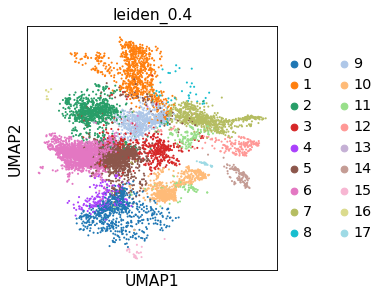

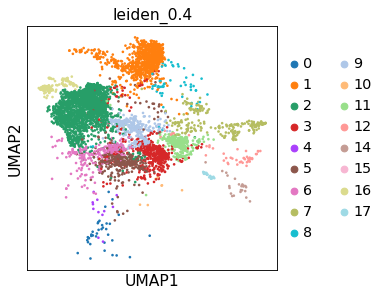

In [19]:
sc.pl.umap(adata_lungN, color = 'leiden_0.4')
sc.pl.umap(adata_lungT, color = 'leiden_0.4')
sc.pl.umap(adata_EBUS, color = 'leiden_0.4')

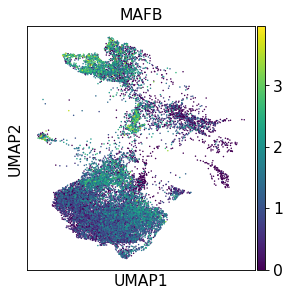

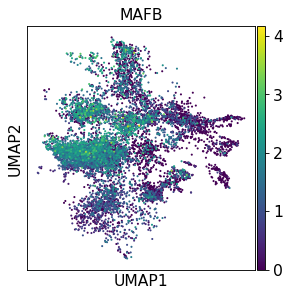

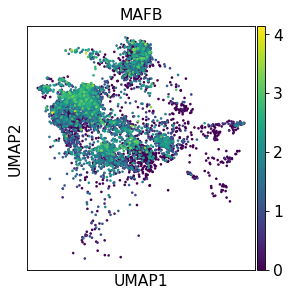

In [20]:
sc.pl.umap(adata_lungN, color = 'MAFB')
sc.pl.umap(adata_lungT, color = 'MAFB')
sc.pl.umap(adata_EBUS, color = 'MAFB')

ranking genes
/home/analysis/miniconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:03:50)


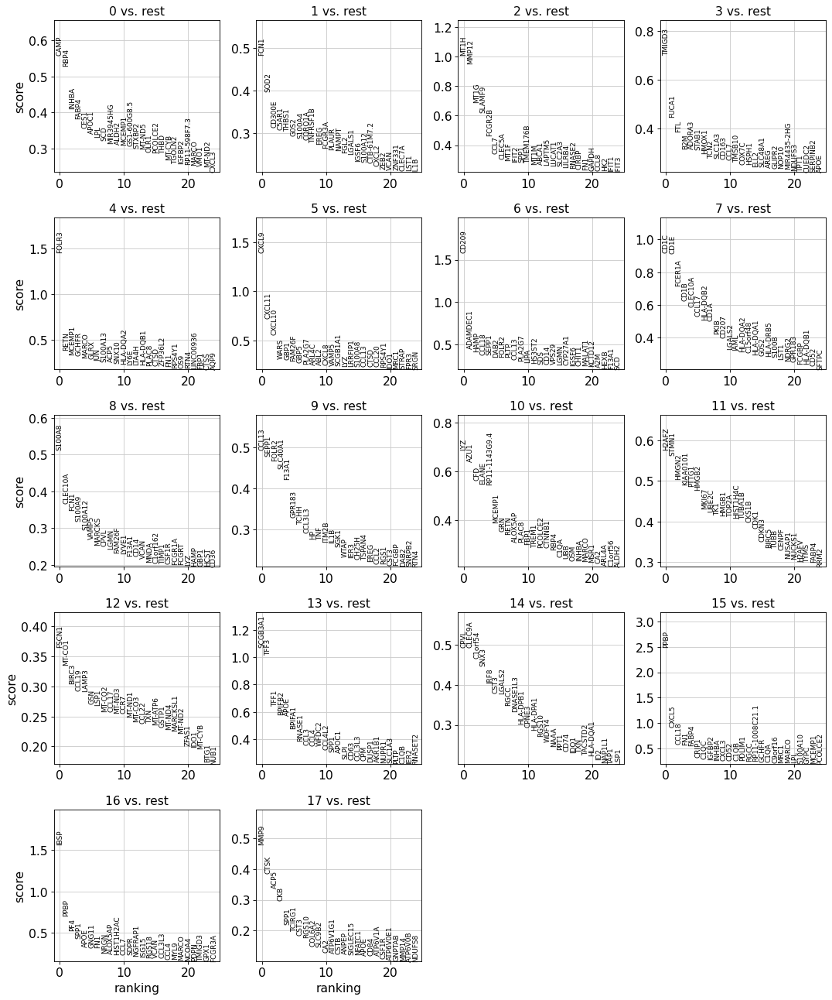

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden_0.4', method='logreg')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [22]:
marker_genes = ['CTSS','FCN1','S100A8','S100A9','LYZ','VCAN', # Monocytes
                'LGMN','CTSB','CD14','FCGR3A', # Macrophage
                'MAFB','MAF','CX3CR1','ITGAM','CSF1R', # mo-linage 
                'MARCO','FABP4','MCEMP1', # Alveolar Macrophage
                'IL1B','CXCL8', #pro-inflammatory macrophages
                'APOE','CD163','SEPP1','C1QB','C1QA','C1QC', # Anti-inflammatory macrophages
               ]

In [23]:
adata

AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_0.6_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

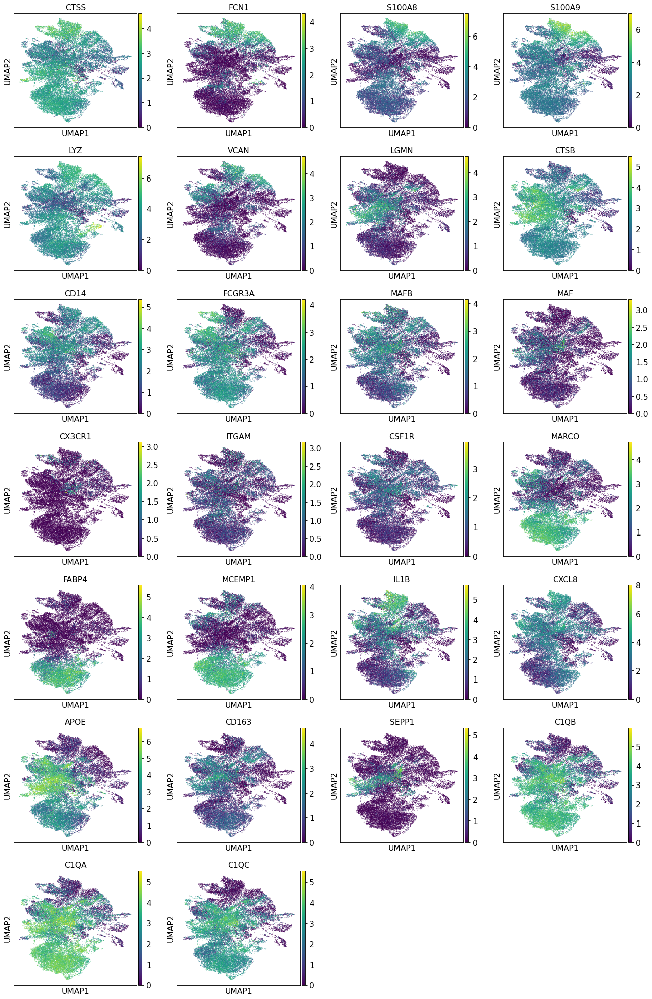

In [24]:
sc.pl.umap(adata, color=marker_genes )

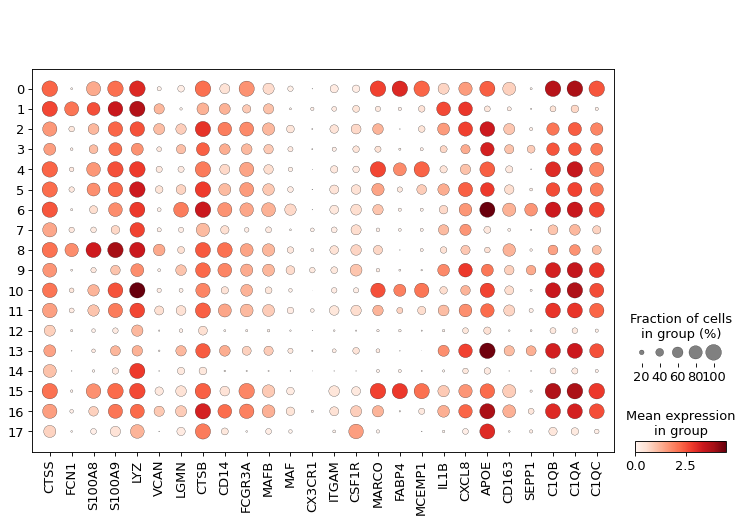

In [25]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden_0.4')

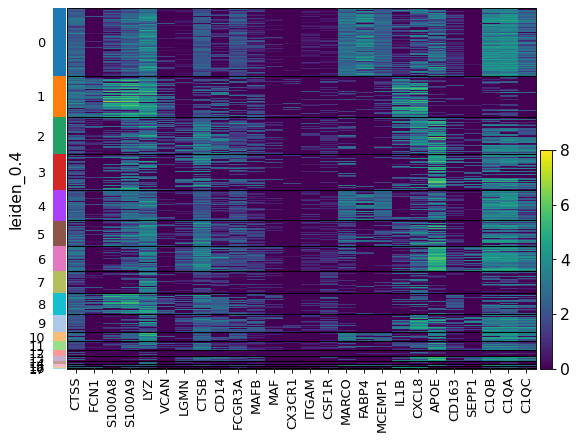

In [26]:
sc.pl.heatmap(adata, marker_genes, groupby='leiden_0.4')

In [27]:
adata_LN = adata[adata.obs_names.str.contains('LN'),:]
adata_LN

View of AnnData object with n_obs × n_vars = 1127 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [28]:
adata_NS = adata[adata.obs_names.str.contains('NS'),:]
adata_NS

View of AnnData object with n_obs × n_vars = 5619 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [29]:
adata_EF = adata[adata.obs_names.str.contains('EFFUSION'),:]
adata_EF

View of AnnData object with n_obs × n_vars = 3055 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [30]:
adata_BR = adata[adata.obs_names.str.contains('BRONCHO'),:]
adata_BR

View of AnnData object with n_obs × n_vars = 1184 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [31]:
adata

AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_0.6_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [32]:
adata_Tumor_IV = adata[adata.obs_names.str.contains('EBUS_06') | adata.obs_names.str.contains('EBUS_28') | adata.obs_names.str.contains('EBUS_49') | adata.obs_names.str.contains('BRONCHO_58'),:]
adata_Tumor_IV

View of AnnData object with n_obs × n_vars = 1212 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [33]:
adata_LN_meta = adata[adata.obs_names.str.contains('EBUS_10') | adata.obs_names.str.contains('BRONCHO_11') | adata.obs_names.str.contains('EBUS_12') | adata.obs_names.str.contains('EBUS_13') | adata.obs_names.str.contains('EBUS_15') | adata.obs_names.str.contains('EBUS_19') | adata.obs_names.str.contains('EBUS_51'),:]
adata_LN_meta

View of AnnData object with n_obs × n_vars = 5333 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [34]:
adata_lungN.obs['sample']="Normal_Lung"
adata_lungT.obs['sample']="Tumor_StageI"
adata_Tumor_IV.obs['sample']="Tumor_StageIV"
adata_LN.obs['sample']="Normal_LN"
adata_LN_meta.obs['sample']="Metastated_LN"
adata_NS.obs['sample']="Brain_Metastasis"
adata_EF.obs['sample']="Pleural_fluids"

adata2 = adata_lungN.concatenate(adata_lungT, adata_Tumor_IV, adata_LN, adata_LN_meta, adata_NS, adata_EF)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [35]:
adata2

AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'sample' as categorical


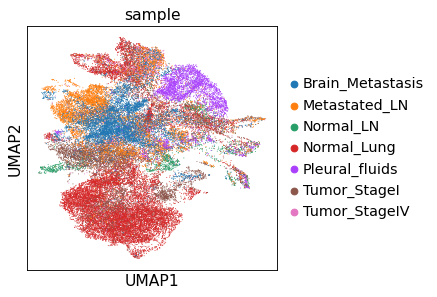

In [36]:
sc.pl.umap(adata2, color = 'sample')

... storing 'sample' as categorical


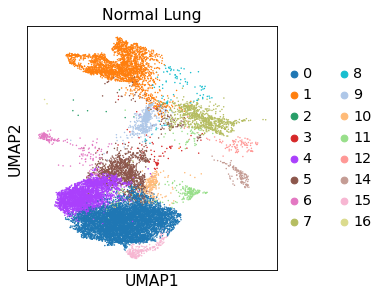

... storing 'sample' as categorical


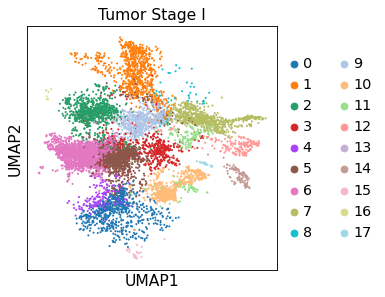

... storing 'sample' as categorical


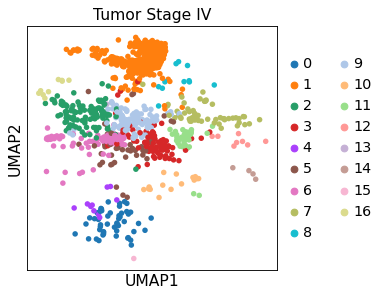

... storing 'sample' as categorical


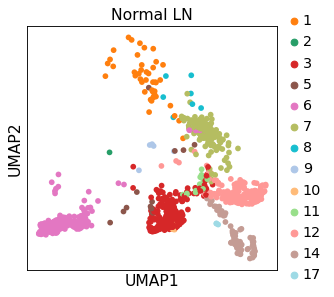

... storing 'sample' as categorical


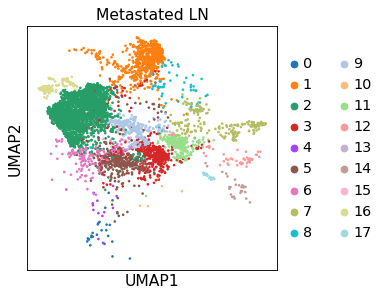

... storing 'sample' as categorical


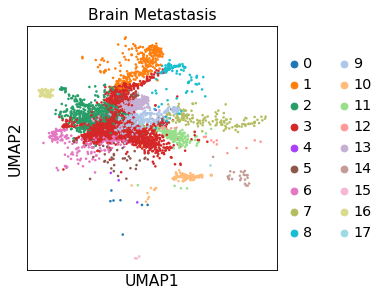

... storing 'sample' as categorical


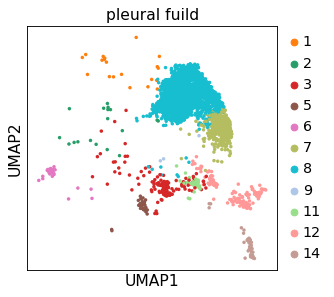

In [37]:
sc.pl.umap(adata_lungN, color = 'leiden_0.4', title = 'Normal Lung')
sc.pl.umap(adata_lungT, color = 'leiden_0.4', title = 'Tumor Stage I')
sc.pl.umap(adata_Tumor_IV, color = 'leiden_0.4', title = 'Tumor Stage IV')
sc.pl.umap(adata_LN, color = 'leiden_0.4', title = 'Normal LN')
sc.pl.umap(adata_LN_meta, color = 'leiden_0.4', title = 'Metastated LN')
sc.pl.umap(adata_NS, color = 'leiden_0.4', title = 'Brain Metastasis')
sc.pl.umap(adata_EF, color = 'leiden_0.4', title = 'pleural fuild')

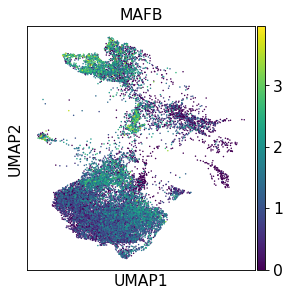

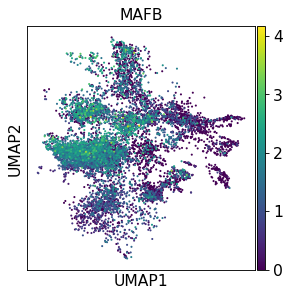

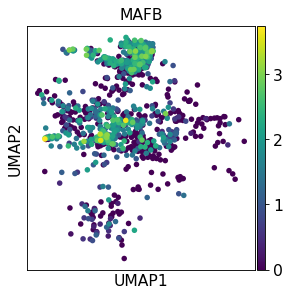

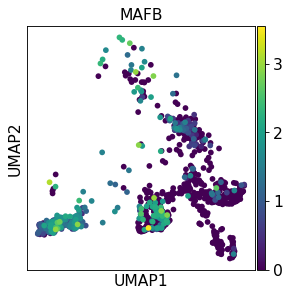

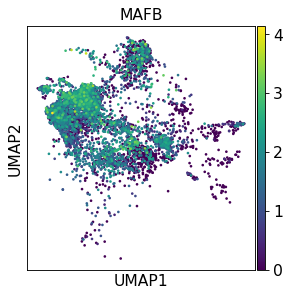

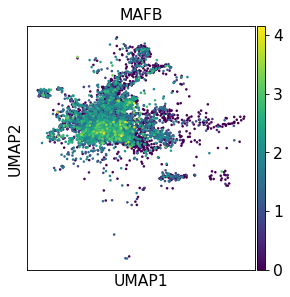

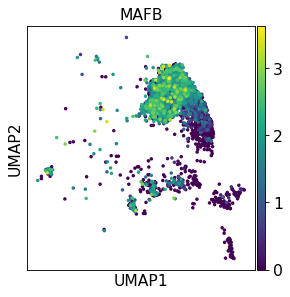

In [38]:
sc.pl.umap(adata_lungN, color = 'MAFB')
sc.pl.umap(adata_lungT, color = 'MAFB')
sc.pl.umap(adata_Tumor_IV, color = 'MAFB')
sc.pl.umap(adata_LN, color = 'MAFB')
sc.pl.umap(adata_LN_meta, color = 'MAFB')
sc.pl.umap(adata_NS, color = 'MAFB')
sc.pl.umap(adata_EF, color = 'MAFB')

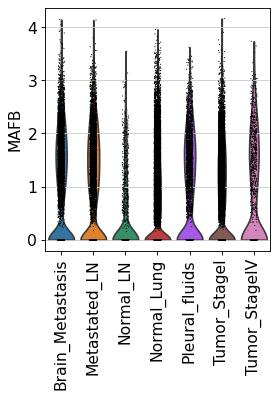

In [39]:
sc.pl.violin(adata2, ['MAFB'], groupby='sample', rotation = 90)

In [40]:
marker_genes_dist = {'monocyte':['CTSS','FCN1','S100A8','S100A9','LYZ','VCAN'], # Monocytes
                    'macreophage':['LGMN','CTSB','CD14','FCGR3A'], # Macrophage
                    'mo-linage':['MAFB','MAF','CX3CR1','ITGAM','CSF1R'], # mo-linage 
                    'alveolar macrophage':['MARCO','FABP4','MCEMP1'], # Alveolar Macrophage
                    'pro-inflammatory myeloid cells':['IL1B','CXCL8'], #pro-inflammatory macrophages
                    'anti-inflammatory myeloid cells':['APOE','CD163','SEPP1','C1QB','C1QA','C1QC'] # Anti-inflammatory macrophages
                    }

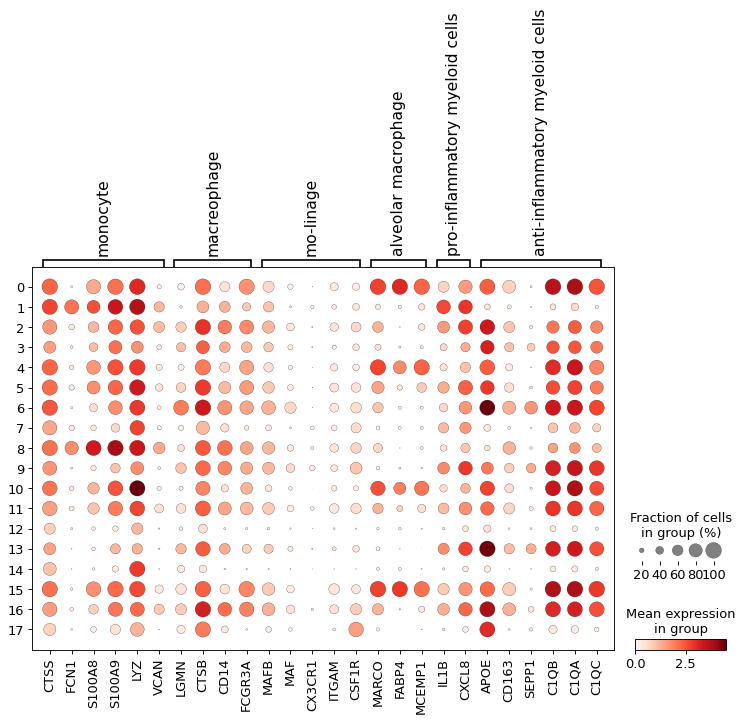

In [41]:
sc.pl.dotplot(adata, marker_genes_dist, groupby='leiden_0.4')

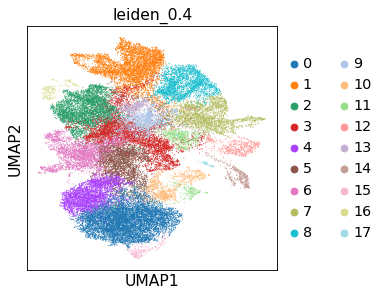

In [42]:
sc.pl.umap(adata2, color = 'leiden_0.4')

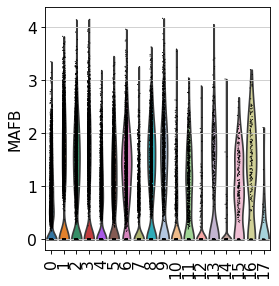

In [43]:
sc.pl.violin(adata2, ['MAFB'], groupby='leiden_0.4', rotation = 90)

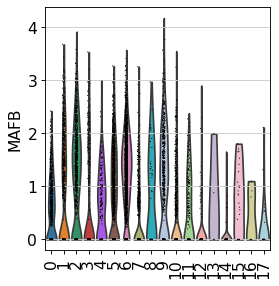

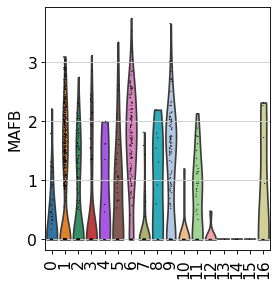

In [44]:
sc.pl.violin(adata_lungT, ['MAFB'], groupby='leiden_0.4', rotation = 90)
sc.pl.violin(adata_Tumor_IV, ['MAFB'], groupby='leiden_0.4', rotation = 90)

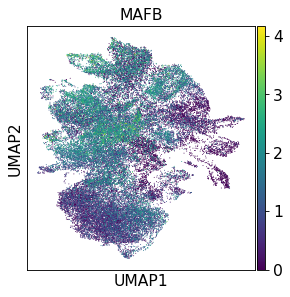

In [45]:
sc.pl.umap(adata2, color = 'MAFB')

In [46]:
adata_lungN.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,leiden_0.6,leiden_0.2,leiden_0.4,leiden_0.8,leiden_1.0,leiden_1.2,sample
AAACCTGAGACAAAGG_LUNG_N18,1100,2990.0,133.0,4.448161,1100,2990.0,1,2,1,2,0,7,Normal_Lung
AAACCTGAGAGCAATT_LUNG_N31,1283,5095.0,123.0,2.414132,1283,5095.0,1,2,1,2,0,2,Normal_Lung
AAACCTGAGAGCCTAG_LUNG_N20,1942,9094.0,458.0,5.036288,1942,9094.0,2,0,4,3,1,1,Normal_Lung
AAACCTGAGATGTGGC_LUNG_N06,3245,20470.0,1557.0,7.606253,3245,20470.0,0,0,0,0,3,4,Normal_Lung
AAACCTGAGCACCGCT_LUNG_N08,2017,8026.0,620.0,7.724894,2017,8026.0,0,0,0,0,4,4,Normal_Lung
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCTAGGGC_LUNG_N01,3746,20235.0,1273.0,6.291080,3746,20235.0,0,0,0,0,2,3,Normal_Lung
TTTGTCATCGAGCCCA_LUNG_N01,1463,4817.0,207.0,4.297280,1463,4817.0,1,2,1,2,0,2,Normal_Lung
TTTGTCATCGGCTACG_LUNG_N31,4868,42049.0,1298.0,3.086875,4868,42049.0,0,0,0,1,3,8,Normal_Lung
TTTGTCATCTGCAGTA_LUNG_N31,1049,3610.0,188.0,5.207756,1049,3610.0,3,2,1,9,0,17,Normal_Lung


In [47]:
adata_lungN.write('write/220302_normal_lung.h5ad')
adata_lungT.write('write/220302_Tumor_stage_I.h5ad')
adata_Tumor_IV.write('write/220302_Tumor_stage_IV.h5ad')
adata_LN.write('write/220302_normal_LN.h5ad')
adata_LN_meta.write('write/220302_metastated_LN.h5ad')
adata_NS.write('write/220302_Brain_Meta.h5ad')
adata_EF.write('write/220302_effusion.h5ad')

In [48]:
gene_list = ['IL4','IL10','IL13','TGFB1','TGFB2','TGFB3',
             'CD163','CD68','MRC1','VEGFA',#MRC1=CD206
             'MAF','MAFB','CD14','PDCD1','CD274',#PDCD1=PD1,CD274=PDL1
             'ARG1','ADGRE1','C1QA','C1QB','C1QC','IL7R','MSR1',#MSR1=CD204
             'MMP13','MMP7','MMP17','MMP12','MMP8','MMP14','MMP19','MMP3','MMP11','MMP2'
]

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_0.4']`


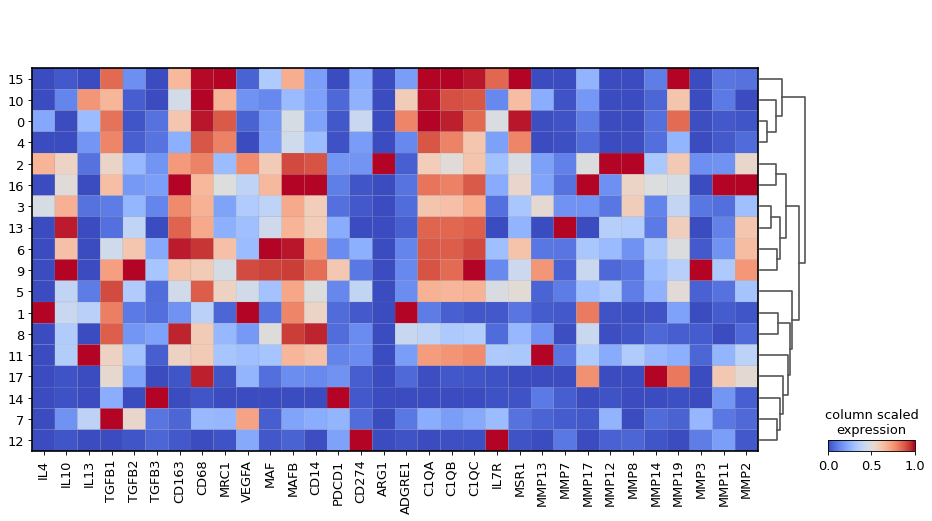

In [49]:
sc.pl.matrixplot(adata, gene_list, use_raw = True,
                 dendrogram=True, groupby = 'leiden_0.4', 
                 cmap='coolwarm', standard_scale='var', 
                 colorbar_title='column scaled\nexpression')

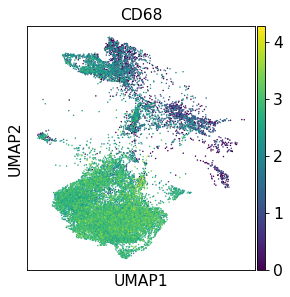

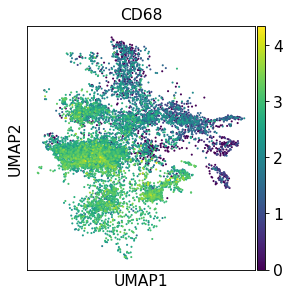

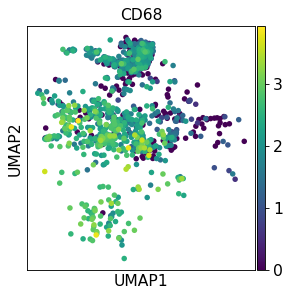

In [50]:
sc.pl.umap(adata_lungN, color = 'CD68')
sc.pl.umap(adata_lungT, color = 'CD68')
sc.pl.umap(adata_Tumor_IV, color = 'CD68')

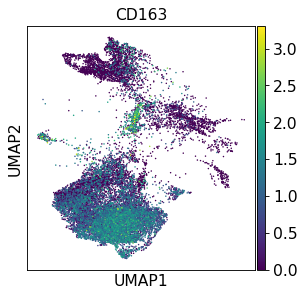

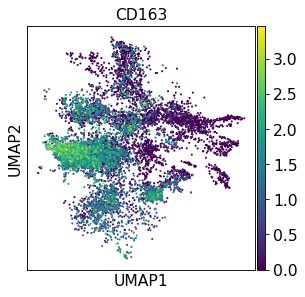

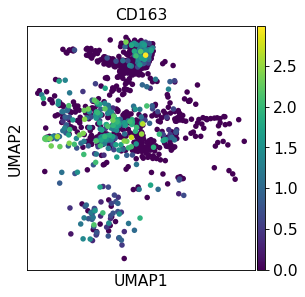

In [51]:
sc.pl.umap(adata_lungN, color = 'CD163')
sc.pl.umap(adata_lungT, color = 'CD163')
sc.pl.umap(adata_Tumor_IV, color = 'CD163')

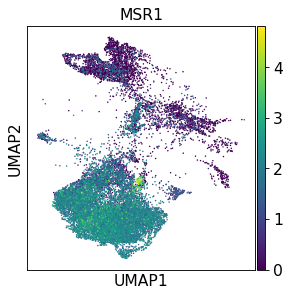

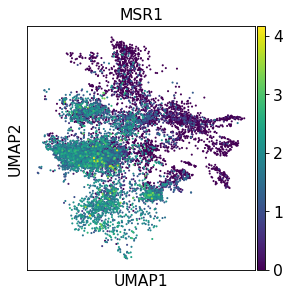

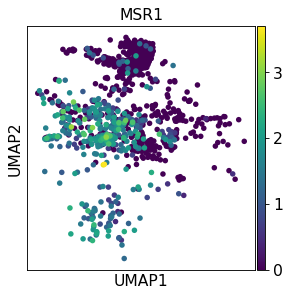

In [52]:
sc.pl.umap(adata_lungN, color = 'MSR1')
sc.pl.umap(adata_lungT, color = 'MSR1')
sc.pl.umap(adata_Tumor_IV, color = 'MSR1')

In [53]:
DC_list = ["CLEC10A",
"CD1C",
"CLEC4C",
"PTCRA",
"CCR7",
"LAMP3"]

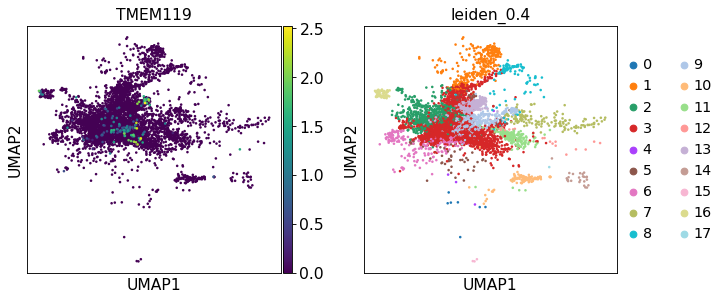

In [54]:
sc.pl.umap(adata_NS, color=['TMEM119','leiden_0.4'])

In [55]:
#for Monocytes
cluster1 = adata2.obs['leiden_0.4'] == '1'
adata_mo = adata2[cluster1,:]

#for pleural macrophages
cluster8 = adata2.obs['leiden_0.4'] == '8'
adata_pl = adata2[cluster8,:]

#for alveolar macs
cluster0 = adata2.obs['leiden_0.4'] == '0'
cluster4 = adata2.obs['leiden_0.4'] == '4'
cluster10 = adata2.obs['leiden_0.4'] == '10'
cluster15 = adata2.obs['leiden_0.4'] == '15'
alveolar = np.add(cluster0, cluster4)
alveolar = np.add(alveolar, cluster10)
alveolar = np.add(alveolar, cluster15)
adata_alv = adata2[alveolar,:]

#for DCs
cluster7 = adata2.obs['leiden_0.4'] == '7'
cluster12 = adata2.obs['leiden_0.4'] == '12'
cluster14 = adata2.obs['leiden_0.4'] == '14'
cluster17 = adata2.obs['leiden_0.4'] == '17'
DCs = np.add(cluster7, cluster12)
DCs = np.add(DCs, cluster14)
DCs = np.add(DCs, cluster17)
adata_dcs = adata2[DCs,:]

#for Mo/Mac
cluster2 = adata2.obs['leiden_0.4'] == '2'
cluster3 = adata2.obs['leiden_0.4'] == '3'
cluster6 = adata2.obs['leiden_0.4'] == '6'
cluster9 = adata2.obs['leiden_0.4'] == '9'
cluster16 = adata2.obs['leiden_0.4'] == '16'
MM = np.add(cluster2, cluster3)
MM = np.add(MM, cluster6)
MM = np.add(MM, cluster9)
MM = np.add(MM, cluster16)
adata_mm = adata2[MM,:]

#for undetermind cells
cluster5 = adata2.obs['leiden_0.4'] == '5'
cluster11 = adata2.obs['leiden_0.4'] == '11'
cluster13 = adata2.obs['leiden_0.4'] == '13'
UD = np.add(cluster5, cluster11)
UD = np.add(UD, cluster13)
adata_ud = adata2[UD,:]

/home/analysis/miniconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  warnings.warn(


In [56]:
adata_mo

View of AnnData object with n_obs × n_vars = 4751 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [57]:
adata_pl

View of AnnData object with n_obs × n_vars = 2458 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [58]:
adata_alv

View of AnnData object with n_obs × n_vars = 12667 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [59]:
adata_dcs

View of AnnData object with n_obs × n_vars = 3667 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [60]:
adata_mm

View of AnnData object with n_obs × n_vars = 13619 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [61]:
adata_ud

View of AnnData object with n_obs × n_vars = 4564 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'leiden_0.4_colors'
    obsm: 'X_pca', 'X_umap'

In [62]:
adata_mo.obs['celltype']="Monocytes"
adata_pl.obs['celltype']="Pleural Macrophages"
adata_alv.obs['celltype']="Alveolar Macrophages"
adata_dcs.obs['celltype']="Dendritic Cells"
adata_mm.obs['celltype']="Monocytes/Macrophages"
adata_ud.obs['celltype']="Undetermind"

adata3 = adata_mo.concatenate(adata_pl, adata_alv, adata_dcs, adata_mm, adata_ud)
adata3

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'sample' as categorical
... storing 'celltype' as categorical


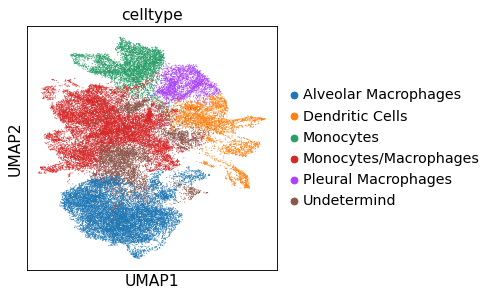

In [63]:
sc.pl.umap(adata3, color='celltype')

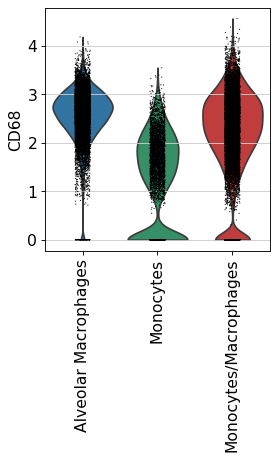

In [64]:
groupby_order = ['Alveolar Macrophages', 'Monocytes','Monocytes/Macrophages']
sc.pl.violin(adata3, 'CD68', groupby='celltype', rotation=90,
    order=groupby_order)

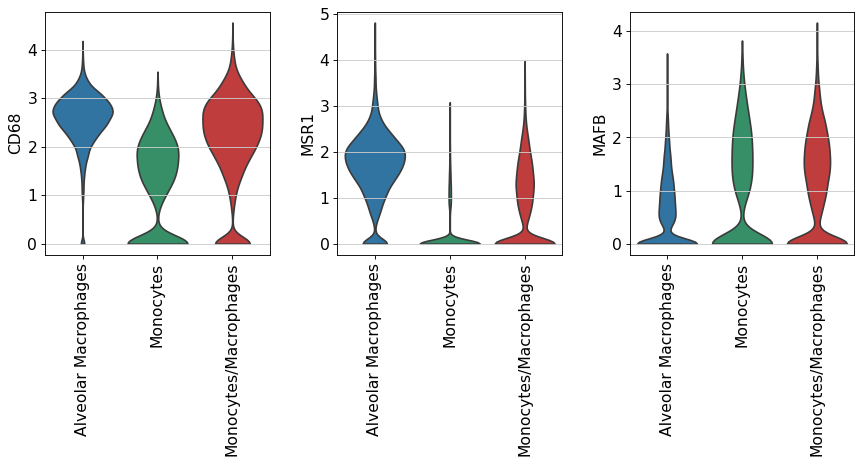

In [65]:
groupby_order = ['Alveolar Macrophages', 'Monocytes','Monocytes/Macrophages']
sc.pl.violin(adata3, ['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

In [66]:
Alveolars=sc.get.obs_df(adata_alv, keys=["CD68","MSR1","MAFB"])
Alveolars.to_csv('220329_AlvMacs_for_fishers_exact_test.tsv', sep='\t', index = True)
Monocytes=sc.get.obs_df(adata_mo, keys=["CD68","MSR1","MAFB"])
Monocytes.to_csv('220329_Monos_for_fishers_exact_test.tsv', sep='\t', index = True)
MMs=s=sc.get.obs_df(adata_mm, keys=["CD68","MSR1","MAFB"])
MMs.to_csv('220329_MonoMacs_for_fishers_exact_test.tsv', sep='\t', index = True)

In [67]:
adata3_lungN = adata3[adata3.obs_names.str.contains('LUNG_N'),:]
adata3_lungT = adata3[adata3.obs_names.str.contains('LUNG_T'),:]
adata3_EBUS = adata3[adata3.obs_names.str.contains('EBUS'),:]

In [68]:
adata3_lungN

View of AnnData object with n_obs × n_vars = 16750 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

In [69]:
adata3_lungT

View of AnnData object with n_obs × n_vars = 8630 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

In [70]:
adata3_EBUS

View of AnnData object with n_obs × n_vars = 5361 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

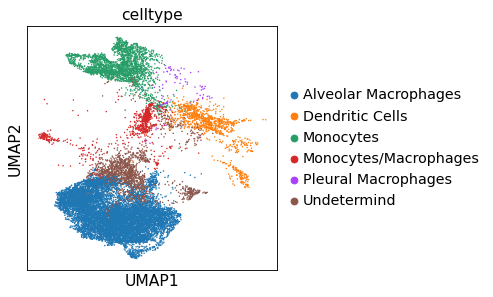

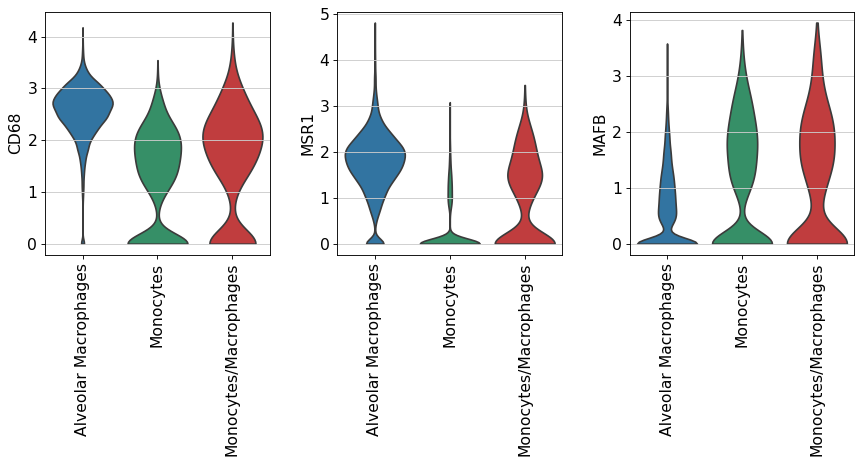

In [71]:
sc.pl.umap(adata3_lungN, color=['celltype'])
sc.pl.violin(adata3_lungN,['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

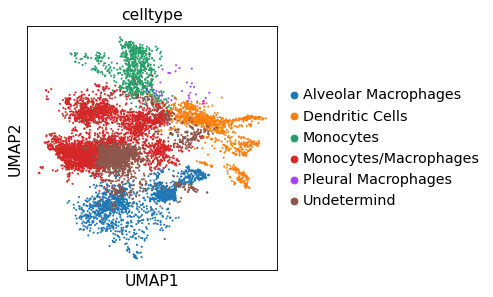

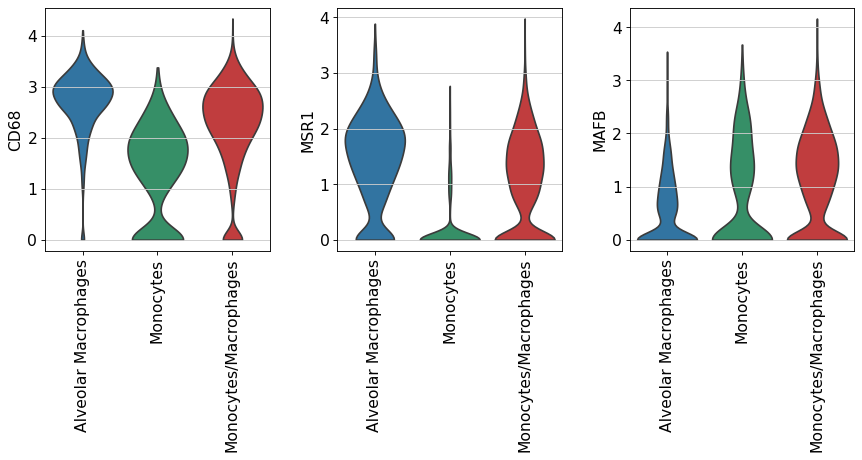

In [72]:
sc.pl.umap(adata3_lungT, color=['celltype'])
sc.pl.violin(adata3_lungT,['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

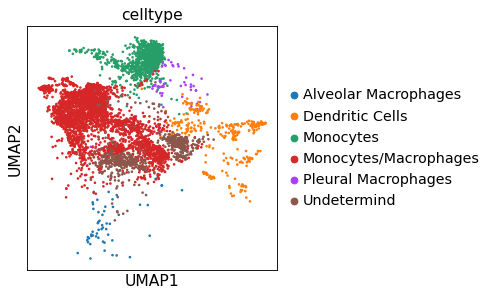

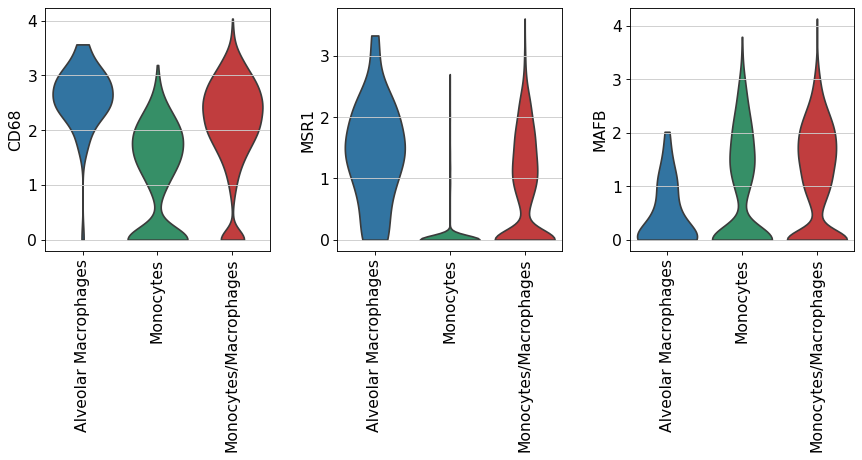

In [73]:
sc.pl.umap(adata3_EBUS, color=['celltype'])
sc.pl.violin(adata3_EBUS,['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

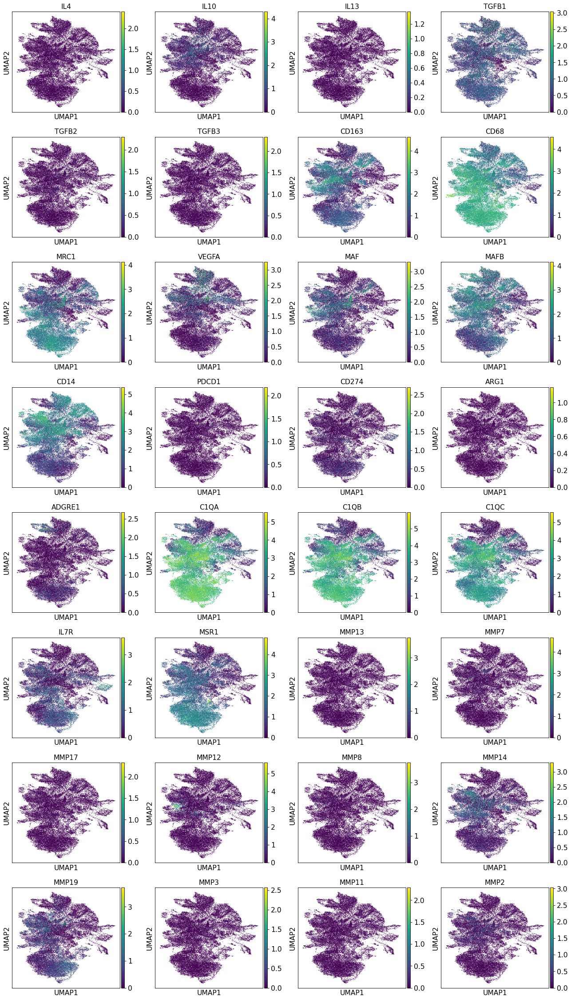

In [74]:
sc.pl.umap(adata3, color=gene_list)

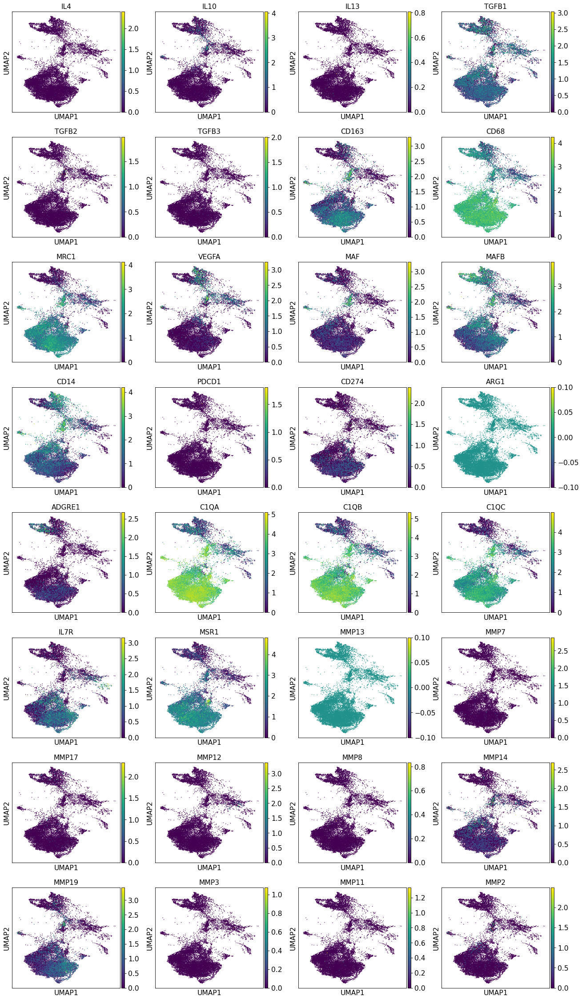

In [75]:
sc.pl.umap(adata3_lungN, color=gene_list)

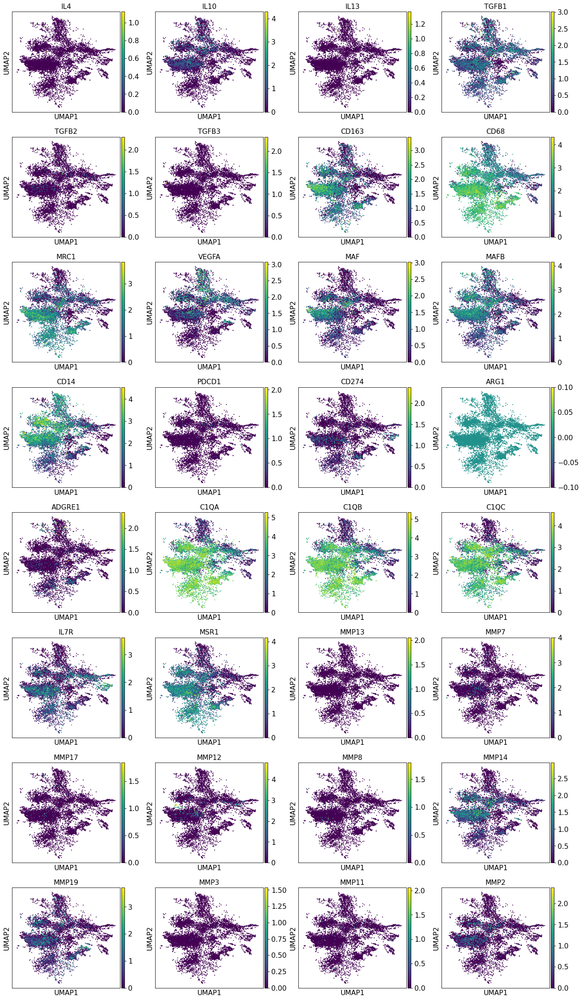

In [76]:
sc.pl.umap(adata3_lungT, color=gene_list)

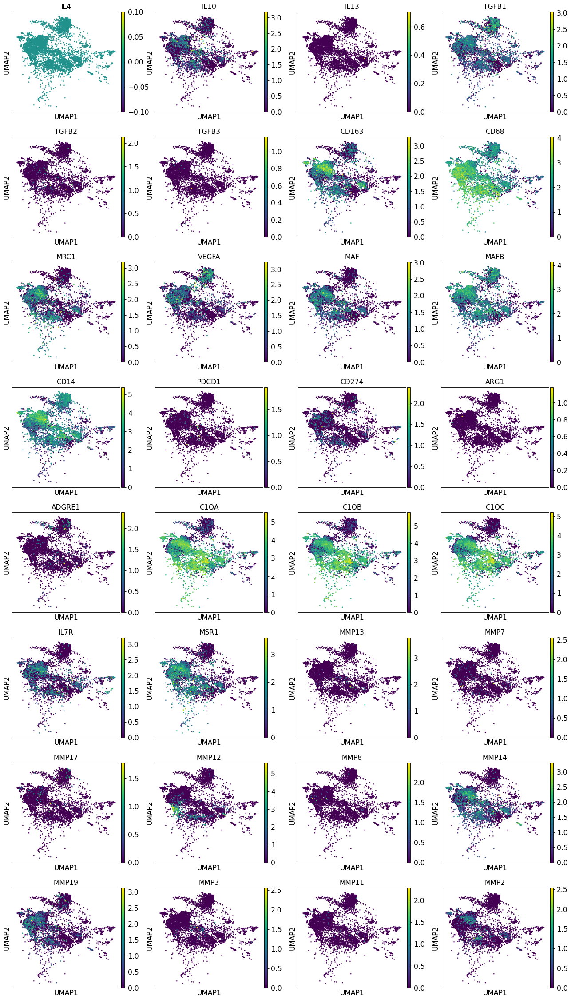

In [77]:
sc.pl.umap(adata3_EBUS, color=gene_list)

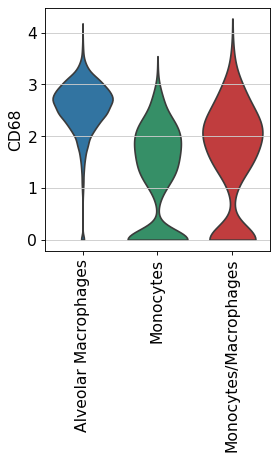

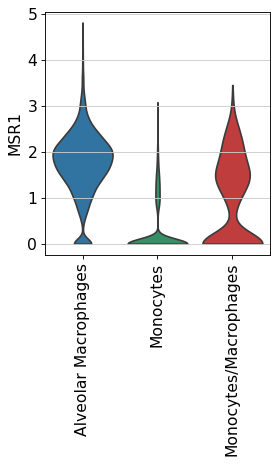

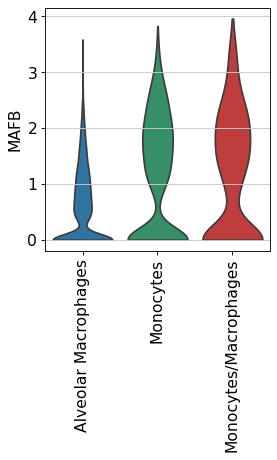

In [78]:
sc.pl.violin(adata3_lungN,'CD68', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_lungN,'MSR1', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_lungN,'MAFB', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

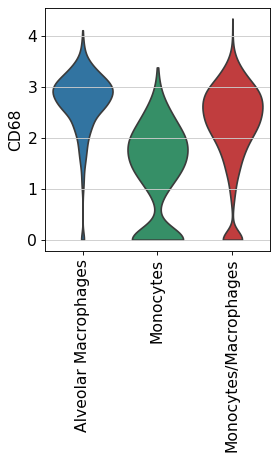

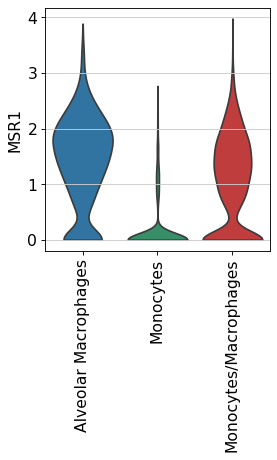

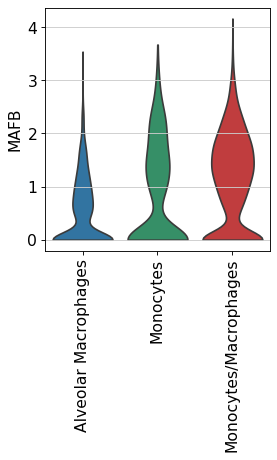

In [79]:
sc.pl.violin(adata3_lungT,'CD68', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_lungT,'MSR1', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_lungT,'MAFB', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

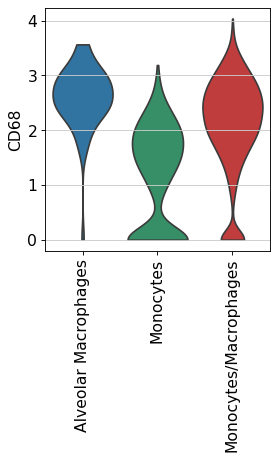

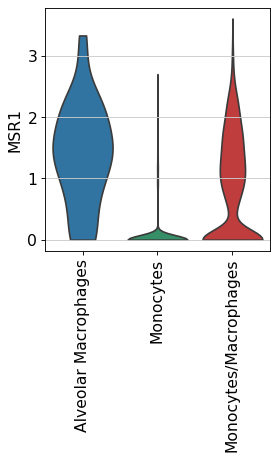

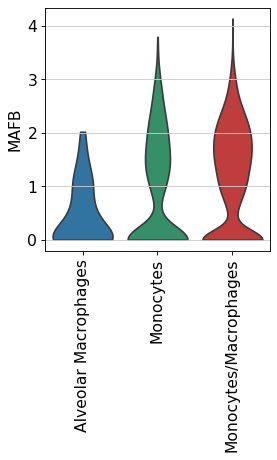

In [80]:
sc.pl.violin(adata3_EBUS,'CD68', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_EBUS,'MSR1', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_EBUS,'MAFB', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

In [81]:
lungN=sc.get.obs_df(adata_lungN, keys=["CD68","MSR1","MAFB"])
lungN.to_csv('220407_normal_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
lungT=sc.get.obs_df(adata_lungT, keys=["CD68","MSR1","MAFB"])
lungT.to_csv('220407_stageI_tumor_for_fishers_exact_test.tsv', sep='\t', index = True)
EBUS=sc.get.obs_df(adata_Tumor_IV, keys=["CD68","MSR1","MAFB"])
EBUS.to_csv('220407_stageIV_tumor_for_fishers_exact_test.tsv', sep='\t', index = True)

In [82]:
adata3_Tumor_IV = adata3[adata3.obs_names.str.contains('EBUS_06') | adata3.obs_names.str.contains('EBUS_28') | adata3.obs_names.str.contains('EBUS_49') | adata3.obs_names.str.contains('BRONCHO_58'),:]
adata3_Tumor_IV

View of AnnData object with n_obs × n_vars = 1212 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

In [83]:
adata3_EBUS

View of AnnData object with n_obs × n_vars = 5361 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

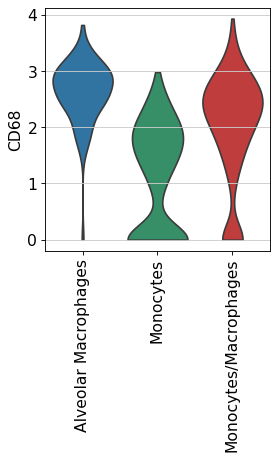

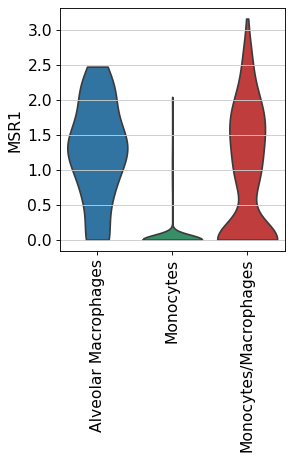

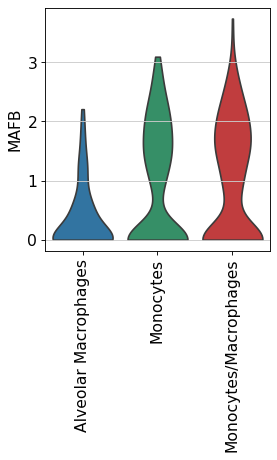

In [84]:
sc.pl.violin(adata3_Tumor_IV,'CD68', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_Tumor_IV,'MSR1', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)
sc.pl.violin(adata3_Tumor_IV,'MAFB', groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order)

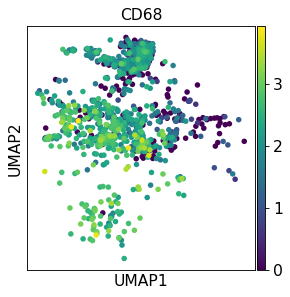

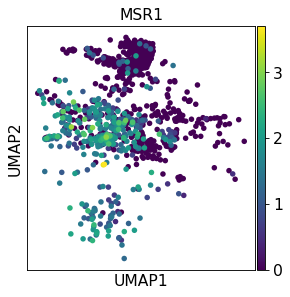

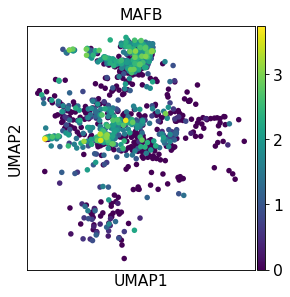

In [85]:
sc.pl.umap(adata3_Tumor_IV, color = 'CD68')
sc.pl.umap(adata3_Tumor_IV, color = 'MSR1')
sc.pl.umap(adata3_Tumor_IV, color = 'MAFB')

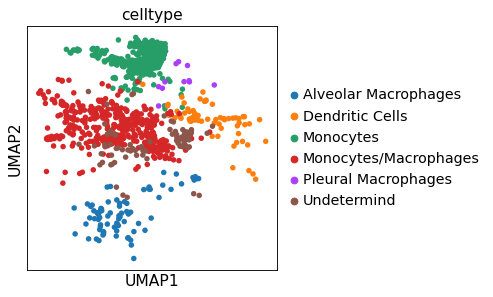

In [86]:
sc.pl.umap(adata3_Tumor_IV, color = 'celltype')

In [87]:
normal_Mo = adata3_lungN.obs['celltype'] == 'Monocytes'
normal_MM = adata3_lungN.obs['celltype'] == 'Monocytes/Macrophages'
normal_Mo_MM = np.add(normal_Mo, normal_MM)
adata3_no_Mo_MM = adata3_lungN[normal_Mo_MM,:]
normal=sc.get.obs_df(adata3_no_Mo_MM, keys=["CD68","MSR1","MAFB"])
normal.to_csv('220407_normal_lung_Mo_MM_for_fishers_exact_test.tsv', sep='\t', index = True)

stageI_Mo = adata3_lungT.obs['celltype'] == 'Monocytes'
stageI_MM = adata3_lungT.obs['celltype'] == 'Monocytes/Macrophages'
stageI_Mo_MM = np.add(stageI_Mo, stageI_MM)
adata3_stageI_Mo_MM = adata3_lungT[stageI_Mo_MM,:]
stageI=sc.get.obs_df(adata3_stageI_Mo_MM, keys=["CD68","MSR1","MAFB"])
stageI.to_csv('220407_stageI_Mo_MM_for_fishers_exact_test.tsv', sep='\t', index = True)

stageIV_Mo = adata3_Tumor_IV.obs['celltype'] == 'Monocytes'
stageIV_MM = adata3_Tumor_IV.obs['celltype'] == 'Monocytes/Macrophages'
stageIV_Mo_MM = np.add(stageIV_Mo, stageIV_MM)
adata3_stageIV_Mo_MM = adata3_Tumor_IV[stageIV_Mo_MM,:]
stageIV=sc.get.obs_df(adata3_stageIV_Mo_MM, keys=["CD68","MSR1","MAFB"])
stageIV.to_csv('220407_stageIV_Mo_MM_for_fishers_exact_test.tsv', sep='\t', index = True)

/home/analysis/miniconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  warnings.warn(


In [88]:
#for Monocytes
cluster1_1 = adata2.obs['leiden_0.4'] == '1'
adata_mo_1 = adata2[cluster1_1,:]

#for alveolar macs
cluster0_1 = adata2.obs['leiden_0.4'] == '0'
cluster4_1 = adata2.obs['leiden_0.4'] == '4'
cluster10_1 = adata2.obs['leiden_0.4'] == '10'
cluster15_1 = adata2.obs['leiden_0.4'] == '15'
alveolar_1 = np.add(cluster0_1, cluster4_1)
alveolar_1 = np.add(alveolar_1, cluster10_1)
alveolar_1 = np.add(alveolar_1, cluster15_1)
adata_alv_1 = adata2[alveolar_1,:]

#for DCs
cluster7_1 = adata2.obs['leiden_0.4'] == '7'
cluster12_1 = adata2.obs['leiden_0.4'] == '12'
cluster14_1 = adata2.obs['leiden_0.4'] == '14'
cluster17_1 = adata2.obs['leiden_0.4'] == '17'
DCs_1 = np.add(cluster7_1, cluster12_1)
DCs_1 = np.add(DCs_1, cluster14_1)
DCs_1 = np.add(DCs_1, cluster17_1)
adata_dcs_1 = adata2[DCs_1,:]

#for macrophage lineages
cluster2_1 = adata2.obs['leiden_0.4'] == '2'
cluster3_1 = adata2.obs['leiden_0.4'] == '3'
cluster6_1 = adata2.obs['leiden_0.4'] == '6'
cluster9_1 = adata2.obs['leiden_0.4'] == '9'
cluster16_1 = adata2.obs['leiden_0.4'] == '16'
cluster5_1 = adata2.obs['leiden_0.4'] == '5'
cluster11_1 = adata2.obs['leiden_0.4'] == '11'
cluster13_1 = adata2.obs['leiden_0.4'] == '13'
cluster8_1 = adata2.obs['leiden_0.4'] == '8'
ML = np.add(cluster2_1, cluster3_1)
ML = np.add(ML, cluster6_1)
ML = np.add(ML, cluster9_1)
ML = np.add(ML, cluster16_1)
ML = np.add(ML, cluster5_1)
ML = np.add(ML, cluster11_1)
ML = np.add(ML, cluster13_1)
ML = np.add(ML, cluster8_1)
adata_ml = adata2[ML,:]

In [89]:
adata_mo_1.obs['celltype']="Monocytes"
adata_alv_1.obs['celltype']="Alveolar Macrophages"
adata_dcs_1.obs['celltype']="Dendritic Cells"
adata_ml.obs['celltype']="Macrophage Lineages"

adata4 = adata_mo_1.concatenate(adata_alv_1, adata_dcs_1, adata_ml)
adata4

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'sample' as categorical
... storing 'celltype' as categorical


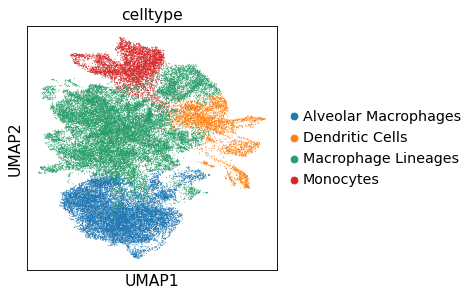

In [90]:
sc.pl.umap(adata4, color = "celltype")

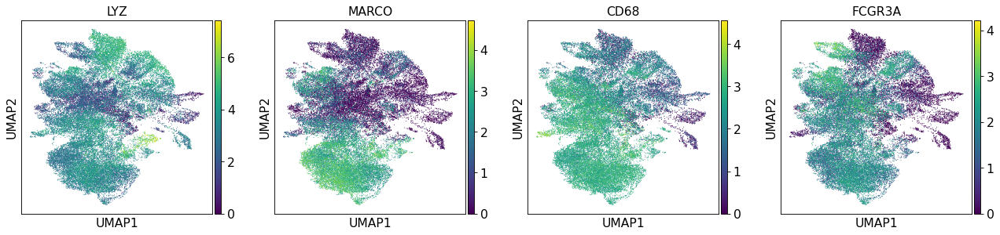

In [91]:
sc.pl.umap(adata3, color=["LYZ","MARCO","CD68","FCGR3A"])

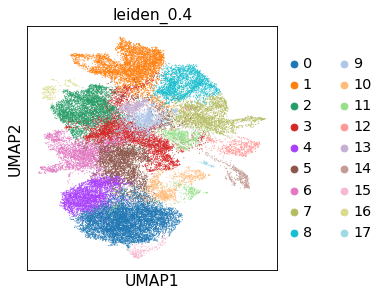

In [92]:
sc.pl.umap(adata3, color="leiden_0.4")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_0.4']`


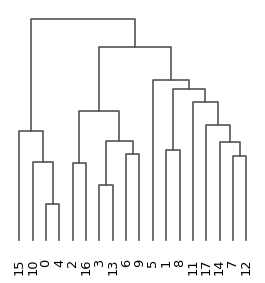

<AxesSubplot:>

In [93]:
sc.tl.dendrogram(adata3, 'leiden_0.4')
sc.pl.dendrogram(adata3, 'leiden_0.4')

In [94]:
#for Monocytes
cluster1_2 = adata2.obs['leiden_0.4'] == '1'
cluster8_2 = adata2.obs['leiden_0.4'] == '8'
Mo_2 = np.add(cluster1_2, cluster8_2)
adata_mo_2 = adata2[Mo_2,:]

#for alveolar macs
cluster0_2 = adata2.obs['leiden_0.4'] == '0'
cluster4_2 = adata2.obs['leiden_0.4'] == '4'
cluster10_2 = adata2.obs['leiden_0.4'] == '10'
cluster15_2 = adata2.obs['leiden_0.4'] == '15'
alveolar_2 = np.add(cluster0_2, cluster4_2)
alveolar_2 = np.add(alveolar_2, cluster10_2)
alveolar_2 = np.add(alveolar_2, cluster15_2)
adata_alv_2 = adata2[alveolar_2,:]

#for DCs
cluster7_2 = adata2.obs['leiden_0.4'] == '7'
cluster12_2 = adata2.obs['leiden_0.4'] == '12'
cluster14_2 = adata2.obs['leiden_0.4'] == '14'
cluster17_2 = adata2.obs['leiden_0.4'] == '17'
DCs_2 = np.add(cluster7_2, cluster12_2)
DCs_2 = np.add(DCs_2, cluster14_2)
DCs_2 = np.add(DCs_2, cluster17_2)
adata_dcs_2 = adata2[DCs_2,:]

#for macrophage lineages
cluster2_2 = adata2.obs['leiden_0.4'] == '2'
cluster3_2 = adata2.obs['leiden_0.4'] == '3'
cluster6_2 = adata2.obs['leiden_0.4'] == '6'
cluster9_2 = adata2.obs['leiden_0.4'] == '9'
cluster16_2 = adata2.obs['leiden_0.4'] == '16'
cluster5_2 = adata2.obs['leiden_0.4'] == '5'
cluster11_2 = adata2.obs['leiden_0.4'] == '11'
cluster13_2 = adata2.obs['leiden_0.4'] == '13'
ML_2 = np.add(cluster2_2, cluster3_2)
ML_2 = np.add(ML_2, cluster6_2)
ML_2 = np.add(ML_2, cluster9_2)
ML_2 = np.add(ML_2, cluster16_2)
ML_2 = np.add(ML_2, cluster5_2)
ML_2 = np.add(ML_2, cluster11_2)
ML_2 = np.add(ML_2, cluster13_2)
adata_ml_2 = adata2[ML_2,:]

/home/analysis/miniconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  warnings.warn(


In [95]:
adata_mo_2.obs['celltype']="Monocytes"
adata_alv_2.obs['celltype']="Alveolar Macrophages"
adata_dcs_2.obs['celltype']="Dendritic Cells"
adata_ml_2.obs['celltype']="Macrophage Lineages"

adata5 = adata_mo_2.concatenate(adata_alv_2, adata_dcs_2, adata_ml_2)
adata5

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 41726 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'sample' as categorical
... storing 'celltype' as categorical


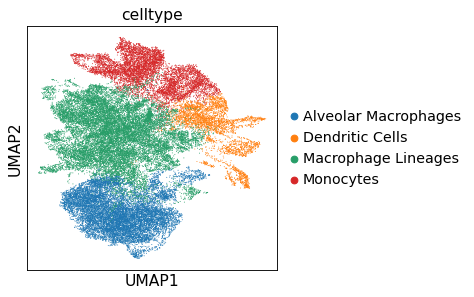

In [96]:
sc.pl.umap(adata5, color = "celltype")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`


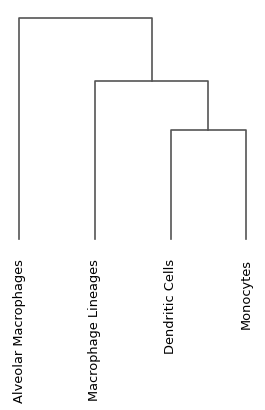

<AxesSubplot:>

In [97]:
sc.tl.dendrogram(adata5, 'celltype')
sc.pl.dendrogram(adata5, 'celltype')

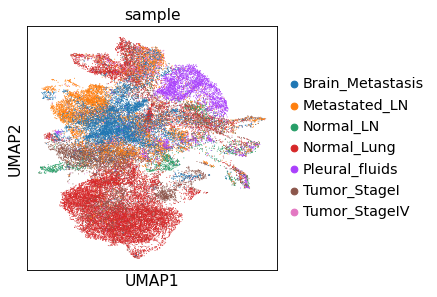

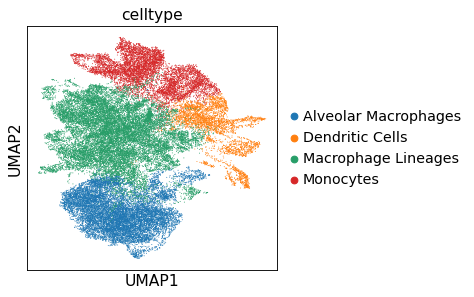

In [98]:
sc.pl.umap(adata5, color = "sample")
sc.pl.umap(adata5, color = "celltype")

In [99]:
adata5_lungN = adata5[adata5.obs_names.str.contains('LUNG_N'),:]
adata5_lungT = adata5[adata5.obs_names.str.contains('LUNG_T'),:]
adata5_Tumor_IV = adata5[adata5.obs_names.str.contains('EBUS_06') | adata5.obs_names.str.contains('EBUS_28') | adata5.obs_names.str.contains('EBUS_49') | adata5.obs_names.str.contains('BRONCHO_58'),:]

In [100]:
adata5_lungN

View of AnnData object with n_obs × n_vars = 16750 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

In [101]:
adata5_lungT

View of AnnData object with n_obs × n_vars = 8630 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

In [102]:
adata5_Tumor_IV

View of AnnData object with n_obs × n_vars = 1212 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

In [103]:
normal_monocyte = adata5_lungN.obs['celltype'] == 'Monocytes'
adata5_mo_normal = adata5_lungN[normal_monocyte,:]
normal_mac = adata5_lungN.obs['celltype'] == 'Macrophage Lineages'
adata5_mac_normal = adata5_lungN[normal_mac,:]
normal_alv = adata5_lungN.obs['celltype'] == 'Alveolar Macrophages'
adata5_alv_normal = adata5_lungN[normal_alv,:]
normal_dc = adata5_lungN.obs['celltype'] == 'Dendritic Cells'
adata5_dc_normal = adata5_lungN[normal_dc,:]

stageI_monocyte = adata5_lungT.obs['celltype'] == 'Monocytes'
adata5_mo_stageI = adata5_lungT[stageI_monocyte,:]
stageI_mac = adata5_lungT.obs['celltype'] == 'Macrophage Lineages'
adata5_mac_stageI = adata5_lungT[stageI_mac,:]
stageI_alv = adata5_lungT.obs['celltype'] == 'Alveolar Macrophages'
adata5_alv_stageI = adata5_lungT[stageI_alv,:]
stageI_dc = adata5_lungT.obs['celltype'] == 'Dendritic Cells'
adata5_dc_stageI = adata5_lungT[stageI_dc,:]

stageIV_monocyte = adata5_Tumor_IV.obs['celltype'] == 'Monocytes'
adata5_mo_stageIV = adata5_Tumor_IV[stageIV_monocyte,:]
stageIV_mac = adata5_Tumor_IV.obs['celltype'] == 'Macrophage Lineages'
adata5_mac_stageIV = adata5_Tumor_IV[stageIV_mac,:]
stageIV_alv = adata5_Tumor_IV.obs['celltype'] == 'Alveolar Macrophages'
adata5_alv_stageIV = adata5_Tumor_IV[stageIV_alv,:]
stageIV_dc = adata5_Tumor_IV.obs['celltype'] == 'Dendritic Cells'
adata5_dc_stageIV = adata5_Tumor_IV[stageIV_dc,:]

adata5_mo_normal.obs['type/sample']="Lung Normal/Monocytes"
adata5_mac_normal.obs['type/sample']="Lung Normal/Macrophage Lineage"
adata5_alv_normal.obs['type/sample']="Lung Normal/Alveolar Macrophages"
adata5_dc_normal.obs['type/sample']="Lung Normal/Dendritic Cells"
adata5_mo_stageI.obs['type/sample']="Lung tumor stageI/Monocytes"
adata5_mac_stageI.obs['type/sample']="Lung tumor stageI/Macrophage Lineage"
adata5_alv_stageI.obs['type/sample']="Lung tumor stageI/Alveolar Macrophages"
adata5_dc_stageI.obs['type/sample']="Lung tumor stageI/Dendritic Cells"
adata5_mo_stageIV.obs['type/sample']="Lung tumor stageIV/Monocytes"
adata5_mac_stageIV.obs['type/sample']="Lung tumor stageIV/Macrophage Lineage"
adata5_alv_stageIV.obs['type/sample']="Lung tumor stageIV/Alveolar Macrophages"
adata5_dc_stageIV.obs['type/sample']="Lung tumor stageIV/Dendritic Cells"

adata6 = adata5_mo_normal.concatenate(adata5_mac_normal,adata5_alv_normal,adata5_dc_normal,
                                adata5_mo_stageI,adata5_mac_stageI,adata5_alv_stageI,adata5_dc_stageI,
                                adata5_mo_stageIV,adata5_mac_stageIV,adata5_alv_stageIV,adata5_dc_stageIV)
adata6

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 26592 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'sample' as categorical
... storing 'celltype' as categorical
... storing 'type/sample' as categorical


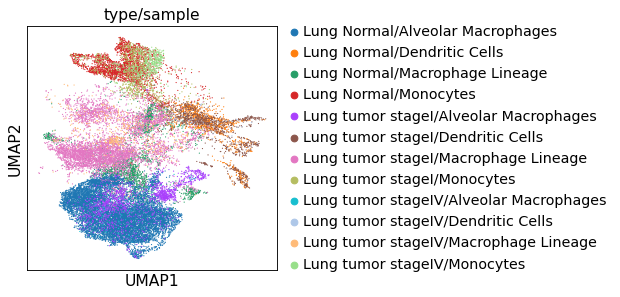

In [104]:
sc.pl.umap(adata6, color='type/sample')

In [105]:
normal_mo = adata6.obs['type/sample'] == 'Lung Normal/Monocytes'
stageI_mo = adata6.obs['type/sample'] == 'Lung tumor stageI/Monocytes'
stageIV_mo = adata6.obs['type/sample'] == 'Lung tumor stageIV/Monocytes'
mo_allstage = np.add(normal_mo, stageI_mo)
mo_allstage = np.add(mo_allstage, stageIV_mo)
adata_mo_allstage = adata6[mo_allstage,:]

normal_mac = adata6.obs['type/sample'] == 'Lung Normal/Macrophage Lineage'
stageI_mac = adata6.obs['type/sample'] == 'Lung tumor stageI/Macrophage Lineage'
stageIV_mac = adata6.obs['type/sample'] == 'Lung tumor stageIV/Macrophage Lineage'
mac_allstage = np.add(normal_mac, stageI_mac)
mac_allstage = np.add(mac_allstage, stageIV_mac)
adata_mac_allstage = adata6[mac_allstage,:]

normal_alv = adata6.obs['type/sample'] == 'Lung Normal/Alveolar Macrophages'
stageI_alv = adata6.obs['type/sample'] == 'Lung tumor stageI/Alveolar Macrophages'
stageIV_alv = adata6.obs['type/sample'] == 'Lung tumor stageIV/Alveolar Macrophages'
alv_allstage = np.add(normal_alv, stageI_alv)
alv_allstage = np.add(alv_allstage, stageIV_alv)
adata_alv_allstage = adata6[alv_allstage,:]

normal_dc = adata6.obs['type/sample'] == 'Lung Normal/Dendritic Cells'
stageI_dc = adata6.obs['type/sample'] == 'Lung tumor stageI/Dendritic Cells'
stageIV_dc = adata6.obs['type/sample'] == 'Lung tumor stageIV/Dendritic Cells'
dc_allstage = np.add(normal_dc, stageI_dc)
dc_allstage = np.add(dc_allstage, stageIV_dc)
adata_dc_allstage = adata6[dc_allstage,:]

/home/analysis/miniconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  warnings.warn(


In [106]:
adata_mo_allstage

View of AnnData object with n_obs × n_vars = 3922 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'type/sample_colors'
    obsm: 'X_pca', 'X_umap'

In [107]:
adata_mac_allstage

View of AnnData object with n_obs × n_vars = 8055 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'type/sample_colors'
    obsm: 'X_pca', 'X_umap'

In [108]:
adata_alv_allstage

View of AnnData object with n_obs × n_vars = 12490 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'type/sample_colors'
    obsm: 'X_pca', 'X_umap'

In [109]:
adata_dc_allstage

View of AnnData object with n_obs × n_vars = 2125 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'type/sample_colors'
    obsm: 'X_pca', 'X_umap'

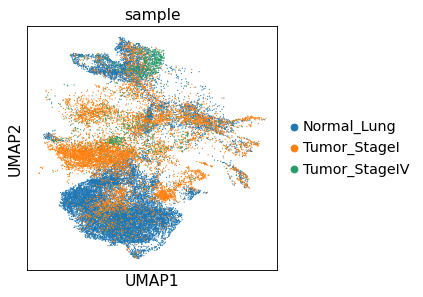

In [110]:
sc.pl.umap(adata6, color='sample')

In [111]:
mo_tumor = np.add(stageI_mo, stageIV_mo)
adata_mo_tumor = adata6[mo_tumor,:]
mac_tumor = np.add(stageI_mac, stageIV_mac)
adata_mac_tumor = adata6[mac_tumor,:]
alv_tumor = np.add(stageI_alv, stageIV_alv)
adata_alv_tumor = adata6[alv_tumor,:]

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


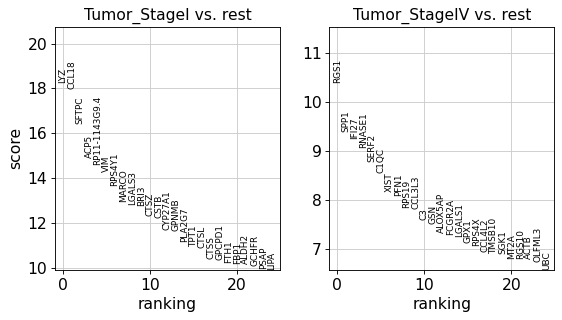

In [112]:
sc.tl.rank_genes_groups(adata_mac_tumor, 'sample', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata_mac_tumor, n_genes=25, sharey=False, key='wilcoxon')

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished: added to `.uns['wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


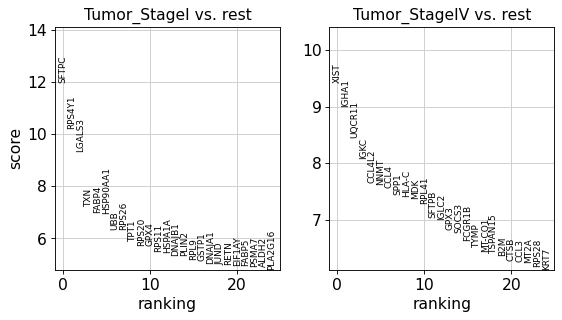

In [113]:
sc.tl.rank_genes_groups(adata_alv_tumor, 'sample', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata_alv_tumor, n_genes=25, sharey=False, key='wilcoxon')

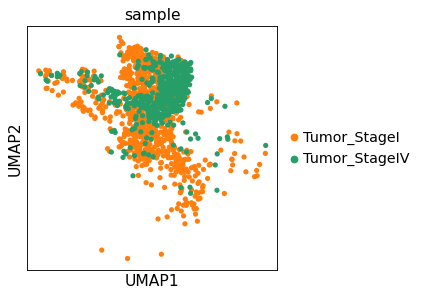

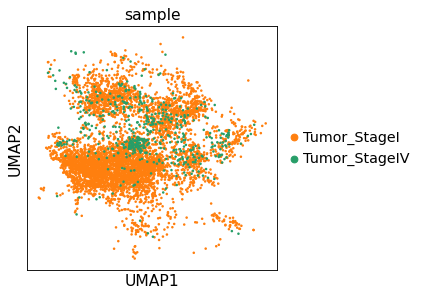

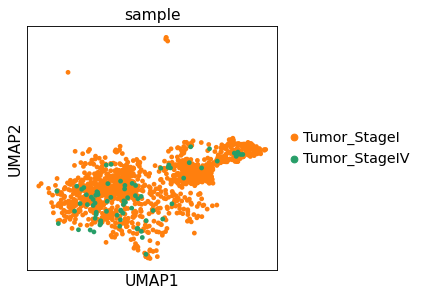

In [114]:
sc.pl.umap(adata_mo_tumor, color='sample')
sc.pl.umap(adata_mac_tumor, color='sample')
sc.pl.umap(adata_alv_tumor, color='sample')

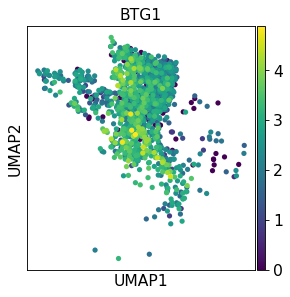

In [115]:
sc.pl.umap(adata_mo_tumor, color='BTG1')

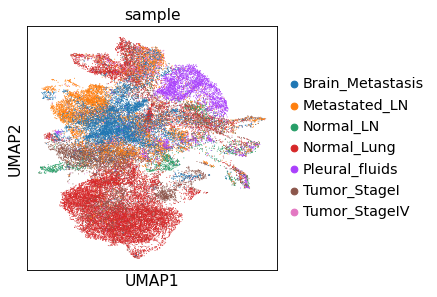

In [116]:
sc.pl.umap(adata5, color='sample')

In [117]:
adata5_normal = adata5[adata5.obs['sample'] == 'Normal_Lung',:]
adata5_normal

View of AnnData object with n_obs × n_vars = 16750 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

In [118]:
adata5_stageI = adata5[adata5.obs['sample'] == 'Tumor_StageI',:]
adata5_stageI

View of AnnData object with n_obs × n_vars = 8630 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

In [119]:
adata5_stageIV = adata5[adata5.obs['sample'] == 'Tumor_StageIV',:]
adata5_stageIV

View of AnnData object with n_obs × n_vars = 1212 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype_colors', 'dendrogram_celltype', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

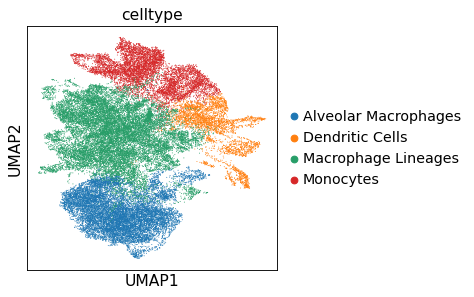

In [120]:
sc.pl.umap(adata5, color='celltype')

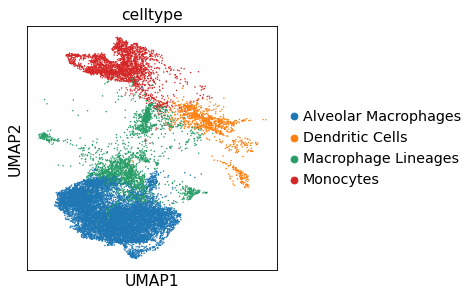

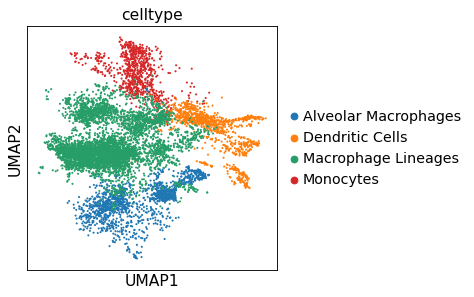

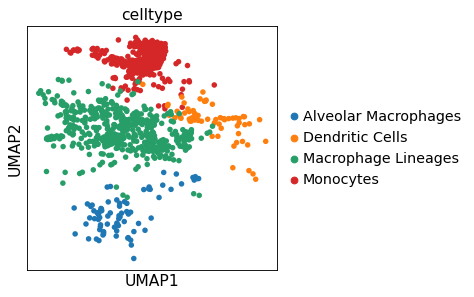

In [121]:
sc.pl.umap(adata5_lungN, color='celltype')
sc.pl.umap(adata5_lungT, color='celltype')
sc.pl.umap(adata5_Tumor_IV, color='celltype')

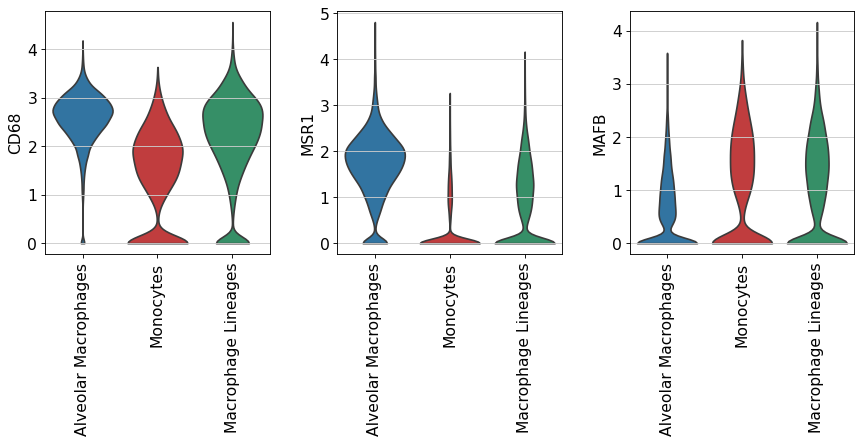

In [122]:
groupby_order_redo = ['Alveolar Macrophages', 'Monocytes','Macrophage Lineages']
sc.pl.violin(adata5, ['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

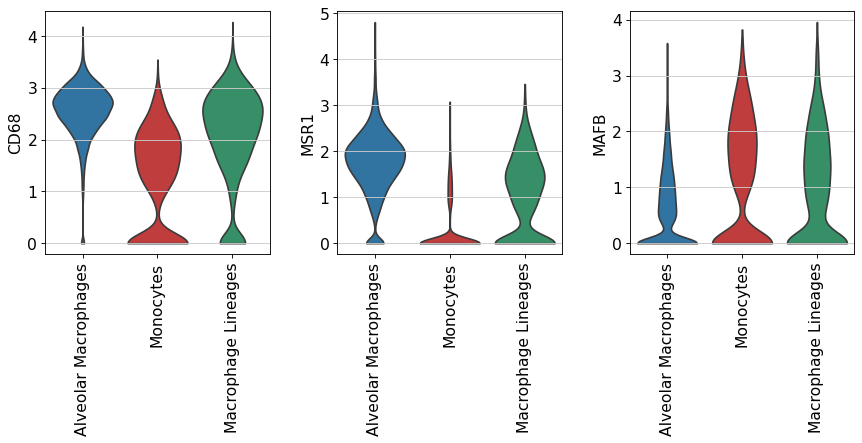

In [123]:
sc.pl.violin(adata5_lungN, ['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

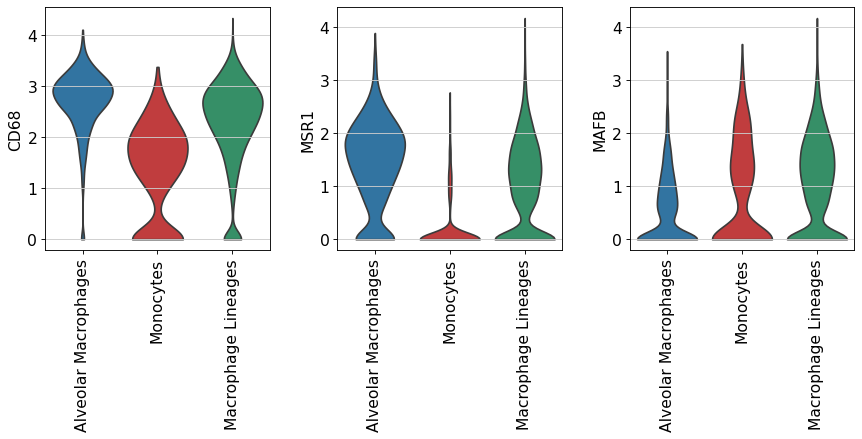

In [124]:
sc.pl.violin(adata5_lungT, ['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

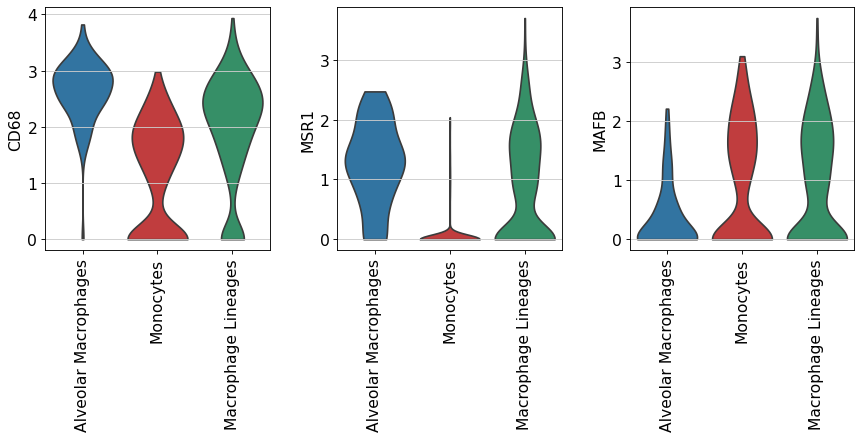

In [125]:
sc.pl.violin(adata5_Tumor_IV, ['CD68','MSR1','MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

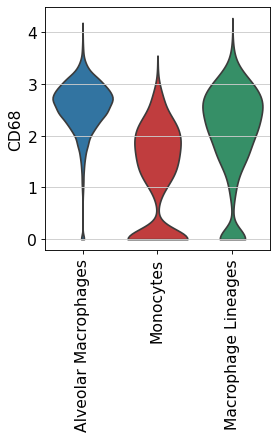

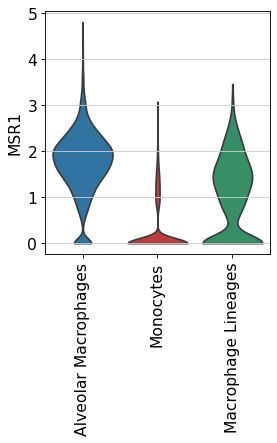

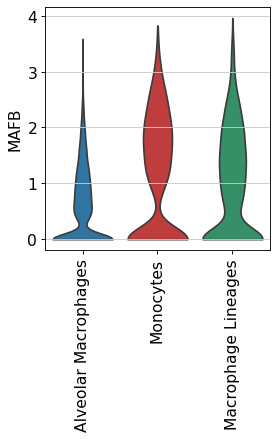

In [126]:
sc.pl.violin(adata5_lungN, ['CD68'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_lungN, ['MSR1'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_lungN, ['MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

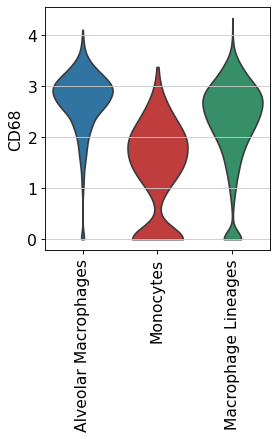

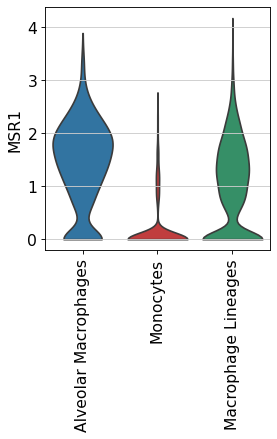

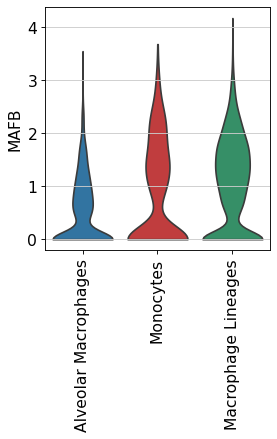

In [127]:
sc.pl.violin(adata5_lungT, ['CD68'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_lungT, ['MSR1'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_lungT, ['MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

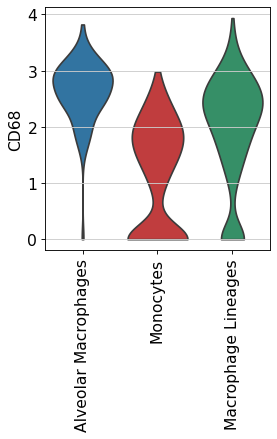

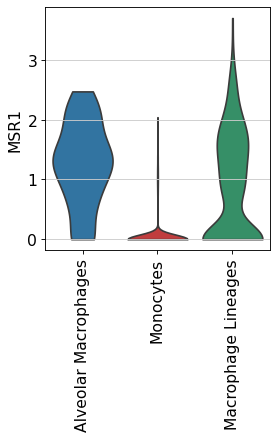

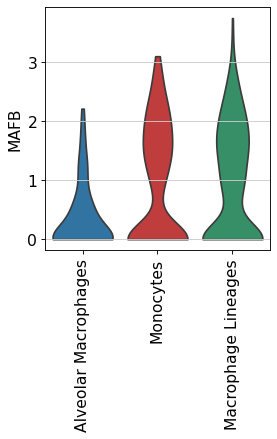

In [128]:
sc.pl.violin(adata5_Tumor_IV, ['CD68'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_Tumor_IV, ['MSR1'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)
sc.pl.violin(adata5_Tumor_IV, ['MAFB'], groupby='celltype', rotation=90, stripplot=False,
    order=groupby_order_redo)

In [129]:
marker_1 = ['MAFB','VEGFA','CD14','MMP12','MMP13']
marker_2 = ['MMP7','MMP17','MMP8','MMP14','MMP2']
marker_3 = ['TGFB1','TGFB2','TGFB3','MMP3','IL10','ARG1','IL4']
marker_4 = ['MMP19','MMP13','IL13','MMP19','CD163','CD68','MRC1','MSR1','PDCD1','CD274','ADGRE1','C1QA','C1QB','C1QC','IL7R']

In [130]:
adata6_mono = adata6[adata6.obs['celltype'] == 'Monocytes',:]
adata6_alv = adata6[adata6.obs['celltype'] == 'Alveolar Macrophages',:]
adata6_mac = adata6[adata6.obs['celltype'] == 'Macrophage Lineages',:]
adata6_dc = adata6[adata6.obs['celltype'] == 'Dendritic Cells',:]

In [131]:
adata6_mono.obs['celltype2']="3"
adata6_alv.obs['celltype2']="1"
adata6_dc.obs['celltype2']="2"
adata6_mac.obs['celltype2']="4"

adata7 = adata6_mono.concatenate(adata6_alv,adata6_dc,adata6_mac)
adata7

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


AnnData object with n_obs × n_vars = 26592 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    obsm: 'X_pca', 'X_umap'

In [132]:
adata6

AnnData object with n_obs × n_vars = 26592 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'type/sample_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'

... storing 'leiden_0.6' as categorical
... storing 'leiden_0.2' as categorical
... storing 'leiden_0.4' as categorical
... storing 'leiden_0.8' as categorical
... storing 'leiden_1.0' as categorical
... storing 'leiden_1.2' as categorical
... storing 'celltype' as categorical
... storing 'type/sample' as categorical
... storing 'celltype2' as categorical


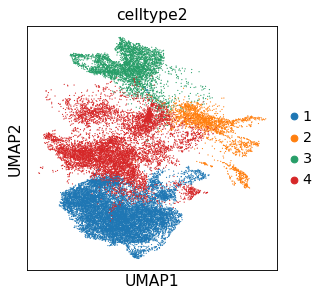

In [133]:
sc.pl.umap(adata7, color = 'celltype2')

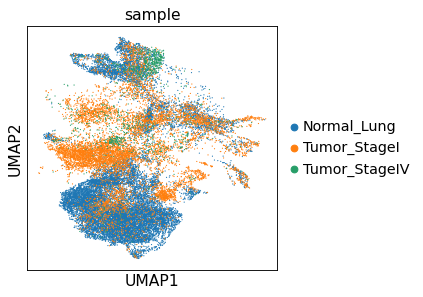

In [134]:
sc.pl.umap(adata7, color = 'sample')

In [135]:
adata7_lungN = adata7[adata7.obs['sample'] == 'Normal_Lung', :]
adata7_lungT = adata7[adata7.obs['sample'] == 'Tumor_StageI', :]
adata7_lungTIV = adata7[adata7.obs['sample'] == 'Tumor_StageIV', :]

In [136]:
norm_mo=sc.get.obs_df(adata5_mo_normal, keys=["CD68","MSR1","MAFB"])
norm_mo.to_csv('220409_mo_normal_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
norm_mac=sc.get.obs_df(adata5_mac_normal, keys=["CD68","MSR1","MAFB"])
norm_mac.to_csv('220409_mac_normal_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
norm_alv=sc.get.obs_df(adata5_alv_normal, keys=["CD68","MSR1","MAFB"])
norm_alv.to_csv('220409_alv_normal_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
norm_dc=sc.get.obs_df(adata5_mac_normal, keys=["CD68","MSR1","MAFB"])
norm_dc.to_csv('220409_dc_normal_lung_for_fishers_exact_test.tsv', sep='\t', index = True)

stageI_mo=sc.get.obs_df(adata5_mo_stageI, keys=["CD68","MSR1","MAFB"])
stageI_mo.to_csv('220409_mo_stageI_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageI_mac=sc.get.obs_df(adata5_mac_stageI, keys=["CD68","MSR1","MAFB"])
stageI_mac.to_csv('220409_mac_stageI_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageI_alv=sc.get.obs_df(adata5_alv_stageI, keys=["CD68","MSR1","MAFB"])
stageI_alv.to_csv('220409_alv_stageI_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageI_dc=sc.get.obs_df(adata5_mac_stageI, keys=["CD68","MSR1","MAFB"])
stageI_dc.to_csv('220409_dc_stageI_lung_for_fishers_exact_test.tsv', sep='\t', index = True)

stageIV_mo=sc.get.obs_df(adata5_mo_stageIV, keys=["CD68","MSR1","MAFB"])
stageIV_mo.to_csv('220409_mo_stageIV_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageIV_mac=sc.get.obs_df(adata5_mac_stageIV, keys=["CD68","MSR1","MAFB"])
stageIV_mac.to_csv('220409_mac_stageIV_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageIV_alv=sc.get.obs_df(adata5_alv_stageIV, keys=["CD68","MSR1","MAFB"])
stageIV_alv.to_csv('220409_alv_stageIV_lung_for_fishers_exact_test.tsv', sep='\t', index = True)
stageIV_dc=sc.get.obs_df(adata5_mac_stageIV, keys=["CD68","MSR1","MAFB"])
stageIV_dc.to_csv('220409_dc_stageIV_lung_for_fishers_exact_test.tsv', sep='\t', index = True)

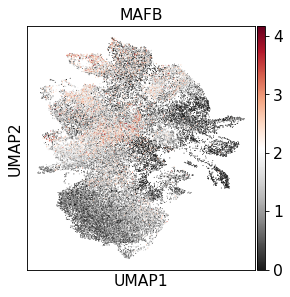

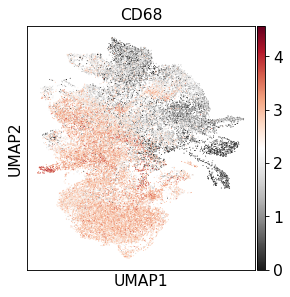

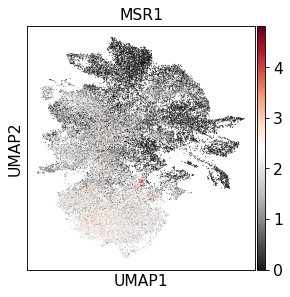

In [137]:
sc.pl.umap(adata3, color='MAFB', color_map='RdGy_r')
sc.pl.umap(adata3, color='CD68', color_map='RdGy_r')
sc.pl.umap(adata3, color='MSR1', color_map='RdGy_r')

In [138]:
adata7.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,leiden_0.6,leiden_0.2,leiden_0.4,leiden_0.8,leiden_1.0,leiden_1.2,sample,batch,celltype,type/sample,celltype2
AAACCTGAGACAAAGG_LUNG_N18-0-0-0-0,1100,2990.0,133.0,4.448161,1100,2990.0,1,2,1,2,0,7,Normal_Lung,0,Monocytes,Lung Normal/Monocytes,3
AAACCTGAGAGCAATT_LUNG_N31-0-0-0-0,1283,5095.0,123.0,2.414132,1283,5095.0,1,2,1,2,0,2,Normal_Lung,0,Monocytes,Lung Normal/Monocytes,3
AAACCTGAGTAATCCC_LUNG_N34-0-0-0-0,507,1094.0,42.0,3.839123,507,1094.0,1,2,1,2,0,2,Normal_Lung,0,Monocytes,Lung Normal/Monocytes,3
AAACCTGCAAGCGAGT_LUNG_N08-0-0-0-0,1610,6406.0,218.0,3.403060,1610,6406.0,1,2,1,13,11,7,Normal_Lung,0,Monocytes,Lung Normal/Monocytes,3
AAACCTGCAATGCCAT_LUNG_N06-0-0-0-0,1619,5848.0,407.0,6.959644,1619,5848.0,1,2,1,13,11,7,Normal_Lung,0,Monocytes,Lung Normal/Monocytes,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGCTGTTCA_EBUS_06-2-3-9-3,1168,3409.0,52.0,1.525374,1168,3409.0,13,3,2,24,26,31,Tumor_StageIV,3,Macrophage Lineages,Lung tumor stageIV/Macrophage Lineage,4
TTTGGTTTCTTGCAAG_EBUS_06-2-3-9-3,747,1791.0,47.0,2.624232,747,1791.0,11,1,3,12,13,12,Tumor_StageIV,3,Macrophage Lineages,Lung tumor stageIV/Macrophage Lineage,4
TTTGTCAAGGGTGTGT_EBUS_06-2-3-9-3,1969,8693.0,313.0,3.600598,1969,8693.0,5,1,6,16,19,19,Tumor_StageIV,3,Macrophage Lineages,Lung tumor stageIV/Macrophage Lineage,4
TTTGTCACAATCGAAA_BRONCHO_58-2-3-9-3,2128,8605.0,292.0,3.393376,2128,8605.0,5,1,9,14,16,18,Tumor_StageIV,3,Macrophage Lineages,Lung tumor stageIV/Macrophage Lineage,4


In [139]:
adata7.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm,mean,std
A2M,False,18910,0.433177,90.930717,90320.0,18910,True,0.482349,3.639923,4.248675,-1.652408e-11,0.503457
A2M-AS1,False,3250,0.016455,98.441292,3431.0,3250,True,0.050549,1.505685,0.778857,2.615934e-12,0.178330
AARD,False,1753,0.015146,99.159257,3158.0,1753,True,0.017604,1.694605,1.179015,-9.913722e-12,0.100642
AATK,False,2592,0.015223,98.756870,3174.0,2592,True,0.023510,1.636142,1.055182,-6.230972e-12,0.115632
ABCA1,False,20542,0.176738,90.148005,36851.0,20542,True,0.197540,1.467033,0.696985,2.040381e-11,0.341059
...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF699,False,3843,0.018906,98.156888,3942.0,3843,True,0.049030,1.398352,0.551511,-1.444433e-11,0.174446
ZNF791,False,27773,0.157516,86.680000,32843.0,27773,True,0.303893,1.431406,0.621523,5.093652e-12,0.438168
ZNF80,False,773,0.004201,99.629267,876.0,773,True,0.017121,1.843429,1.494246,2.772262e-12,0.102800
ZNF831,False,2163,0.010594,98.962620,2209.0,2163,True,0.036099,1.485847,0.736836,6.675175e-13,0.151081


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_0.4']`


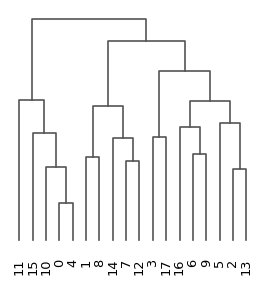

<AxesSubplot:>

In [140]:
sc.tl.dendrogram(adata7, groupby = "leiden_0.4")
sc.pl.dendrogram(adata7, groupby = 'leiden_0.4')

In [141]:
ln_cls0 = adata7_lungN.obs['leiden_0.4'] == '0'
adata7_ln_cls0 = adata7_lungN[ln_cls0,:]

In [142]:
adata7_ln_cls0

View of AnnData object with n_obs × n_vars = 7097 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [143]:
ln_cls4 = adata7_lungN.obs['leiden_0.4'] == '4'
adata7_ln_cls4 = adata7_lungN[ln_cls4,:]

adata7_ln_cls4

View of AnnData object with n_obs × n_vars = 3285 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [144]:
ln_cls10 = adata7_lungN.obs['leiden_0.4'] == '10'
adata7_ln_cls10 = adata7_lungN[ln_cls10,:]

adata7_ln_cls10

View of AnnData object with n_obs × n_vars = 263 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [145]:
ln_cls15 = adata7_lungN.obs['leiden_0.4'] == '15'
adata7_ln_cls15 = adata7_lungN[ln_cls15,:]

adata7_ln_cls15

View of AnnData object with n_obs × n_vars = 221 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [146]:
ln_cls2 = adata7_lungN.obs['leiden_0.4'] == '2'
adata7_ln_cls2 = adata7_lungN[ln_cls2,:]

adata7_ln_cls2

View of AnnData object with n_obs × n_vars = 8 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [147]:
ln_cls3 = adata7_lungN.obs['leiden_0.4'] == '3'
adata7_ln_cls3 = adata7_lungN[ln_cls3,:]

adata7_ln_cls3

View of AnnData object with n_obs × n_vars = 64 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [148]:
ln_cls5 = adata7_lungN.obs['leiden_0.4'] == '5'
adata7_ln_cls5 = adata7_lungN[ln_cls5,:]

adata7_ln_cls5

View of AnnData object with n_obs × n_vars = 1236 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [149]:
ln_cls6 = adata7_lungN.obs['leiden_0.4'] == '6'
adata7_ln_cls6 = adata7_lungN[ln_cls6,:]

adata7_ln_cls6

View of AnnData object with n_obs × n_vars = 189 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [150]:
ln_cls9 = adata7_lungN.obs['leiden_0.4'] == '9'
adata7_ln_cls9 = adata7_lungN[ln_cls9,:]

adata7_ln_cls9

View of AnnData object with n_obs × n_vars = 541 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [151]:
ln_cls11 = adata7_lungN.obs['leiden_0.4'] == '11'
adata7_ln_cls11 = adata7_lungN[ln_cls11,:]

adata7_ln_cls11

View of AnnData object with n_obs × n_vars = 254 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [152]:
ln_cls13 = adata7_lungN.obs['leiden_0.4'] == '13'
adata7_ln_cls13 = adata7_lungN[ln_cls13,:]

adata7_ln_cls13

View of AnnData object with n_obs × n_vars = 0 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [153]:
ln_cls16 = adata7_lungN.obs['leiden_0.4'] == '16'
adata7_ln_cls16 = adata7_lungN[ln_cls16,:]

adata7_ln_cls16

View of AnnData object with n_obs × n_vars = 2 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [154]:
lt_cls0 = adata7_lungT.obs['leiden_0.4'] == '0'
adata7_lt_cls0 = adata7_lungT[lt_cls0,:]
lt_cls4 = adata7_lungT.obs['leiden_0.4'] == '4'
adata7_lt_cls4 = adata7_lungT[lt_cls4,:]
lt_cls10 = adata7_lungT.obs['leiden_0.4'] == '10'
adata7_lt_cls10 = adata7_lungT[lt_cls10,:]
lt_cls15 = adata7_lungT.obs['leiden_0.4'] == '15'
adata7_lt_cls15 = adata7_lungT[lt_cls15,:]
lt_cls2 = adata7_lungT.obs['leiden_0.4'] == '2'
adata7_lt_cls2 = adata7_lungT[lt_cls2,:]
lt_cls3 = adata7_lungT.obs['leiden_0.4'] == '3'
adata7_lt_cls3 = adata7_lungT[lt_cls3,:]
lt_cls5 = adata7_lungT.obs['leiden_0.4'] == '5'
adata7_lt_cls5 = adata7_lungT[lt_cls5,:]
lt_cls6 = adata7_lungT.obs['leiden_0.4'] == '6'
adata7_lt_cls6 = adata7_lungT[lt_cls6,:]
lt_cls9 = adata7_lungT.obs['leiden_0.4'] == '9'
adata7_lt_cls9 = adata7_lungT[lt_cls9,:]
lt_cls11 = adata7_lungT.obs['leiden_0.4'] == '11'
adata7_lt_cls11 = adata7_lungT[lt_cls11,:]
lt_cls13 = adata7_lungT.obs['leiden_0.4'] == '13'
adata7_lt_cls13 = adata7_lungT[lt_cls13,:]
lt_cls16 = adata7_lungT.obs['leiden_0.4'] == '16'
adata7_lt_cls16 = adata7_lungT[lt_cls16,:]

In [155]:
adata7_lt_cls0

View of AnnData object with n_obs × n_vars = 669 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [156]:
adata7_lt_cls4

View of AnnData object with n_obs × n_vars = 181 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [157]:
adata7_lt_cls10

View of AnnData object with n_obs × n_vars = 671 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [158]:
adata7_lt_cls15

View of AnnData object with n_obs × n_vars = 26 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [159]:
adata7_lt_cls2

View of AnnData object with n_obs × n_vars = 813 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [160]:
adata7_lt_cls3

View of AnnData object with n_obs × n_vars = 452 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [161]:
adata7_lt_cls5

View of AnnData object with n_obs × n_vars = 1226 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [162]:
adata7_lt_cls6

View of AnnData object with n_obs × n_vars = 1880 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [163]:
adata7_lt_cls9

View of AnnData object with n_obs × n_vars = 623 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [164]:
adata7_lt_cls11

View of AnnData object with n_obs × n_vars = 206 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [165]:
adata7_lt_cls13 

View of AnnData object with n_obs × n_vars = 4 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [166]:
adata7_lt_cls16

View of AnnData object with n_obs × n_vars = 7 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [167]:
ltiv_cls0 = adata7_lungTIV.obs['leiden_0.4'] == '0'
adata7_ltiv_cls0 = adata7_lungTIV[ltiv_cls0,:]
ltiv_cls4 = adata7_lungTIV.obs['leiden_0.4'] == '4'
adata7_ltiv_cls4 = adata7_lungTIV[ltiv_cls4,:]
ltiv_cls10 = adata7_lungTIV.obs['leiden_0.4'] == '10'
adata7_ltiv_cls10 = adata7_lungTIV[ltiv_cls10,:]
ltiv_cls15 = adata7_lungTIV.obs['leiden_0.4'] == '15'
adata7_ltiv_cls15 = adata7_lungTIV[ltiv_cls15,:]
ltiv_cls2 = adata7_lungTIV.obs['leiden_0.4'] == '2'
adata7_ltiv_cls2 = adata7_lungTIV[ltiv_cls2,:]
ltiv_cls3 = adata7_lungTIV.obs['leiden_0.4'] == '3'
adata7_ltiv_cls3 = adata7_lungTIV[ltiv_cls3,:]
ltiv_cls5 = adata7_lungTIV.obs['leiden_0.4'] == '5'
adata7_ltiv_cls5 = adata7_lungTIV[ltiv_cls5,:]
ltiv_cls6 = adata7_lungTIV.obs['leiden_0.4'] == '6'
adata7_ltiv_cls6 = adata7_lungTIV[ltiv_cls6,:]
ltiv_cls9 = adata7_lungTIV.obs['leiden_0.4'] == '9'
adata7_ltiv_cls9 = adata7_lungTIV[ltiv_cls9,:]
ltiv_cls11 = adata7_lungTIV.obs['leiden_0.4'] == '11'
adata7_ltiv_cls11 = adata7_lungTIV[ltiv_cls11,:]
ltiv_cls13 = adata7_lungTIV.obs['leiden_0.4'] == '13'
adata7_ltiv_cls13 = adata7_lungTIV[ltiv_cls13,:]
ltiv_cls16 = adata7_lungTIV.obs['leiden_0.4'] == '16'
adata7_ltiv_cls16 = adata7_lungTIV[ltiv_cls16,:]

In [168]:
adata7_ltiv_cls0

View of AnnData object with n_obs × n_vars = 50 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [169]:
adata7_ltiv_cls4

View of AnnData object with n_obs × n_vars = 10 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [170]:
adata7_ltiv_cls10

View of AnnData object with n_obs × n_vars = 16 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [171]:
adata7_ltiv_cls15

View of AnnData object with n_obs × n_vars = 1 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [172]:
adata7_ltiv_cls2

View of AnnData object with n_obs × n_vars = 109 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [173]:
adata7_ltiv_cls3

View of AnnData object with n_obs × n_vars = 92 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [174]:
adata7_ltiv_cls5

View of AnnData object with n_obs × n_vars = 44 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [175]:
adata7_ltiv_cls6

View of AnnData object with n_obs × n_vars = 135 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [176]:
adata7_ltiv_cls9

View of AnnData object with n_obs × n_vars = 117 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [177]:
adata7_ltiv_cls11

View of AnnData object with n_obs × n_vars = 43 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [178]:
adata7_ltiv_cls13

View of AnnData object with n_obs × n_vars = 1 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [179]:
adata7_ltiv_cls16

View of AnnData object with n_obs × n_vars = 9 × 2243
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'n_counts', 'leiden_0.6', 'leiden_0.2', 'leiden_0.4', 'leiden_0.8', 'leiden_1.0', 'leiden_1.2', 'sample', 'batch', 'celltype', 'type/sample', 'celltype2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'celltype2_colors', 'sample_colors', 'dendrogram_leiden_0.4'
    obsm: 'X_pca', 'X_umap'

In [180]:
#normal/AMs
sc.get.obs_df(adata7_ln_cls0, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls0_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls4, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls4_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls10, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls10_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls15, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls15_normal_lung.tsv', sep='\t', index = True)
#normal/MLs
sc.get.obs_df(adata7_ln_cls2, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls2_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls3, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls3_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls5, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls5_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls6, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls6_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls9, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls9_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls11, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls11_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls13, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls13_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls16, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls16_normal_lung.tsv', sep='\t', index = True)
#stageI/AMs
sc.get.obs_df(adata7_lt_cls0, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls0_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls4, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls4_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls10, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls10_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls15, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls15_stageI_lung.tsv', sep='\t', index = True)
#stageI/MLs
sc.get.obs_df(adata7_lt_cls2, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls2_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls3, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls3_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls5, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls5_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls6, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls6_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls9, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls9_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls11, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls11_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls13, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls13_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls16, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls16_stageI_lung.tsv', sep='\t', index = True)
#stageIV/AMs
sc.get.obs_df(adata7_ltiv_cls0, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls0_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls4, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls4_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls10, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls10_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls15, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls15_stageIV_lung.tsv', sep='\t', index = True)
#stageIV/MLs
sc.get.obs_df(adata7_ltiv_cls2, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls2_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls3, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls3_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls5, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls5_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls6, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls6_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls9, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls9_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls11, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls11_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls13, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls13_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls16, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220415_cls16_stageIV_lung.tsv', sep='\t', index = True)

In [181]:
ln_cls1 = adata7_lungN.obs['leiden_0.4'] == '1'
adata7_ln_cls1 = adata7_lungN[ln_cls1,:]
ln_cls8 = adata7_lungN.obs['leiden_0.4'] == '8'
adata7_ln_cls8 = adata7_lungN[ln_cls8,:]
lt_cls1 = adata7_lungT.obs['leiden_0.4'] == '1'
adata7_lt_cls1 = adata7_lungT[lt_cls1,:]
lt_cls8 = adata7_lungT.obs['leiden_0.4'] == '8'
adata7_lt_cls8 = adata7_lungT[lt_cls8,:]
ltiv_cls1 = adata7_lungTIV.obs['leiden_0.4'] == '1'
adata7_ltiv_cls1 = adata7_lungTIV[ltiv_cls1,:]
ltiv_cls8 = adata7_lungTIV.obs['leiden_0.4'] == '8'
adata7_ltiv_cls8 = adata7_lungTIV[ltiv_cls8,:]

sc.get.obs_df(adata7_ln_cls1, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls1_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls8, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls8_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls1, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls1_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls8, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls8_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls1, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls1_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls8, keys=["MAFB","VEGFA","MMP12","MMP13","CD68","MRC1","MSR1"]).to_csv('220501_cls8_stageIV_lung.tsv', sep='\t', index = True)

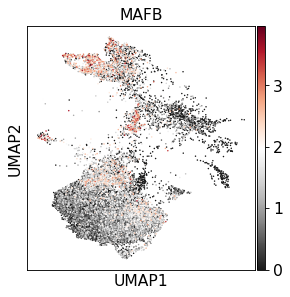

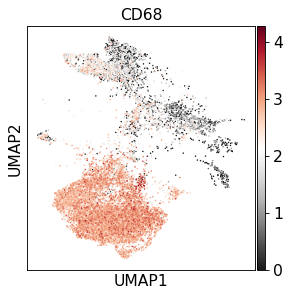

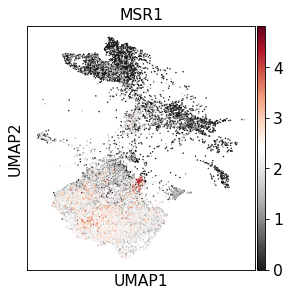

In [182]:
sc.pl.umap(adata3_lungN, color='MAFB', color_map='RdGy_r')
sc.pl.umap(adata3_lungN, color='CD68', color_map='RdGy_r')
sc.pl.umap(adata3_lungN, color='MSR1', color_map='RdGy_r')

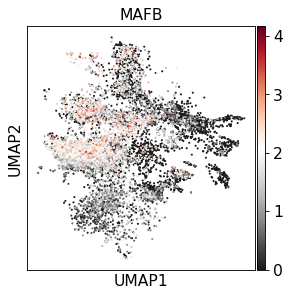

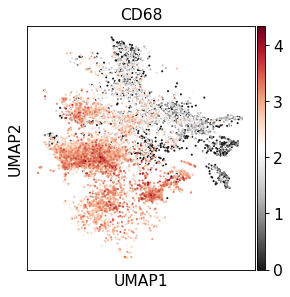

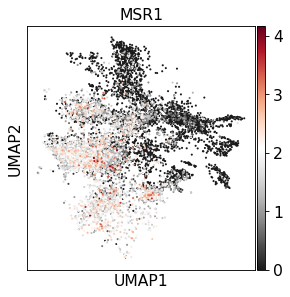

In [183]:
sc.pl.umap(adata3_lungT, color='MAFB', color_map='RdGy_r')
sc.pl.umap(adata3_lungT, color='CD68', color_map='RdGy_r')
sc.pl.umap(adata3_lungT, color='MSR1', color_map='RdGy_r')

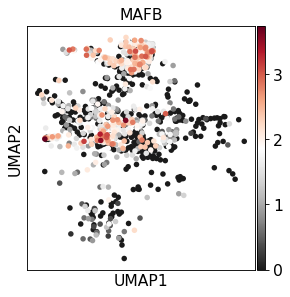

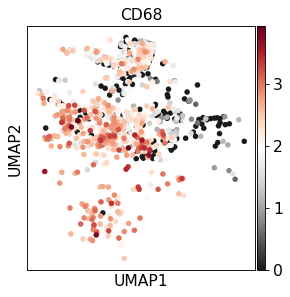

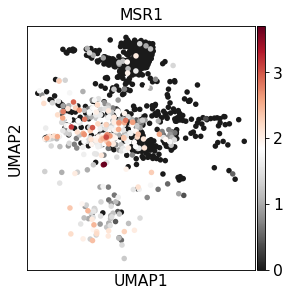

In [184]:
sc.pl.umap(adata3_Tumor_IV, color='MAFB', color_map='RdGy_r')
sc.pl.umap(adata3_Tumor_IV, color='CD68', color_map='RdGy_r')
sc.pl.umap(adata3_Tumor_IV, color='MSR1', color_map='RdGy_r')

In [185]:
#normal/AMs
sc.get.obs_df(adata7_ln_cls0, keys=['CD163','FOLR2']).to_csv('220522_cls0_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls4, keys=['CD163','FOLR2']).to_csv('220522_cls4_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls10, keys=['CD163','FOLR2']).to_csv('220522_cls10_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls15, keys=['CD163','FOLR2']).to_csv('220522_cls15_normal_lung.tsv', sep='\t', index = True)
#normal/MLs
sc.get.obs_df(adata7_ln_cls2, keys=['CD163','FOLR2']).to_csv('220522_cls2_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls3, keys=['CD163','FOLR2']).to_csv('220522_cls3_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls5, keys=['CD163','FOLR2']).to_csv('220522_cls5_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls6, keys=['CD163','FOLR2']).to_csv('220522_cls6_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls9, keys=['CD163','FOLR2']).to_csv('220522_cls9_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls11, keys=['CD163','FOLR2']).to_csv('220522_cls11_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls13, keys=['CD163','FOLR2']).to_csv('220522_cls13_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls16, keys=['CD163','FOLR2']).to_csv('220522_cls16_normal_lung.tsv', sep='\t', index = True)
#stageI/AMs
sc.get.obs_df(adata7_lt_cls0, keys=['CD163','FOLR2']).to_csv('220522_cls0_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls4, keys=['CD163','FOLR2']).to_csv('220522_cls4_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls10, keys=['CD163','FOLR2']).to_csv('220522_cls10_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls15, keys=['CD163','FOLR2']).to_csv('220522_cls15_stageI_lung.tsv', sep='\t', index = True)
#stageI/MLs
sc.get.obs_df(adata7_lt_cls2, keys=['CD163','FOLR2']).to_csv('220522_cls2_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls3, keys=['CD163','FOLR2']).to_csv('220522_cls3_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls5, keys=['CD163','FOLR2']).to_csv('220522_cls5_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls6, keys=['CD163','FOLR2']).to_csv('220522_cls6_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls9, keys=['CD163','FOLR2']).to_csv('220522_cls9_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls11, keys=['CD163','FOLR2']).to_csv('220522_cls11_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls13, keys=['CD163','FOLR2']).to_csv('220522_cls13_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls16, keys=['CD163','FOLR2']).to_csv('220522_cls16_stageI_lung.tsv', sep='\t', index = True)
#stageIV/AMs
sc.get.obs_df(adata7_ltiv_cls0, keys=['CD163','FOLR2']).to_csv('220522_cls0_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls4, keys=['CD163','FOLR2']).to_csv('220522_cls4_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls10, keys=['CD163','FOLR2']).to_csv('22522_cls10_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls15, keys=['CD163','FOLR2']).to_csv('220522_cls15_stageIV_lung.tsv', sep='\t', index = True)
#stageIV/MLs
sc.get.obs_df(adata7_ltiv_cls2, keys=['CD163','FOLR2']).to_csv('220522_cls2_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls3, keys=['CD163','FOLR2']).to_csv('220522_cls3_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls5, keys=['CD163','FOLR2']).to_csv('220522_cls5_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls6, keys=['CD163','FOLR2']).to_csv('220522_cls6_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls9, keys=['CD163','FOLR2']).to_csv('220522_cls9_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls11, keys=['CD163','FOLR2']).to_csv('220522_cls11_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls13, keys=['CD163','FOLR2']).to_csv('220522_cls13_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls16, keys=['CD163','FOLR2']).to_csv('220522_cls16_stageIV_lung.tsv', sep='\t', index = True)
#normal/Mono
sc.get.obs_df(adata7_ln_cls1, keys=['CD163','FOLR2']).to_csv('220522_cls1_normal_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls8, keys=['CD163','FOLR2']).to_csv('220522_cls8_normal_lung.tsv', sep='\t', index = True)
#StageI/Mono
sc.get.obs_df(adata7_lt_cls1, keys=['CD163','FOLR2']).to_csv('220522_cls1_stageI_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls8, keys=['CD163','FOLR2']).to_csv('220522_cls8_stageI_lung.tsv', sep='\t', index = True)
#StageIV/Mono
sc.get.obs_df(adata7_ltiv_cls1, keys=['CD163','FOLR2']).to_csv('220522_cls1_stageIV_lung.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls8, keys=['CD163','FOLR2']).to_csv('220522_cls8_stageIV_lung.tsv', sep='\t', index = True)

In [186]:
#normal/AMs
sc.get.obs_df(adata7_ln_cls0, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls0_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls4, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls4_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls10, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls10_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls15, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls15_normal_lung_marker.tsv', sep='\t', index = True)
#normal/MLs
sc.get.obs_df(adata7_ln_cls2, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls2_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls3, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls3_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls5, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls5_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls6, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls6_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls9, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls9_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls11, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls11_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls13, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls13_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls16, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls16_normal_lung_marker.tsv', sep='\t', index = True)
#stageI/AMs
sc.get.obs_df(adata7_lt_cls0, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls0_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls4, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls4_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls10, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls10_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls15, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls15_stageI_lung_marker.tsv', sep='\t', index = True)
#stageI/MLs
sc.get.obs_df(adata7_lt_cls2, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls2_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls3, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls3_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls5, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls5_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls6, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls6_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls9, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls9_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls11, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls11_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls13, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls13_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls16, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls16_stageI_lung_marker.tsv', sep='\t', index = True)
#stageIV/AMs
sc.get.obs_df(adata7_ltiv_cls0, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls0_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls4, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls4_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls10, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls10_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls15, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls15_stageIV_lung_marker.tsv', sep='\t', index = True)
#stageIV/MLs
sc.get.obs_df(adata7_ltiv_cls2, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls2_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls3, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls3_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls5, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls5_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls6, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls6_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls9, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls9_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls11, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls11_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls13, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls13_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls16, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls16_stageIV_lung_marker.tsv', sep='\t', index = True)
#normal/Mono
sc.get.obs_df(adata7_ln_cls1, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls1_normal_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ln_cls8, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls8_normal_lung_marker.tsv', sep='\t', index = True)
#StageI/Mono
sc.get.obs_df(adata7_lt_cls1, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls1_stageI_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_lt_cls8, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls8_stageI_lung_marker.tsv', sep='\t', index = True)
#StageIV/Mono
sc.get.obs_df(adata7_ltiv_cls1, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls1_stageIV_lung_marker.tsv', sep='\t', index = True)
sc.get.obs_df(adata7_ltiv_cls8, keys=['MARCO','FABP4','MCEMP1','LGMN','CTSB','CD14','FCN1','LYZ']).to_csv('220522_cls8_stageIV_lung_marker.tsv', sep='\t', index = True)

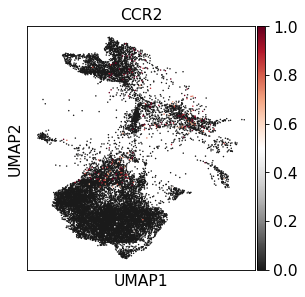

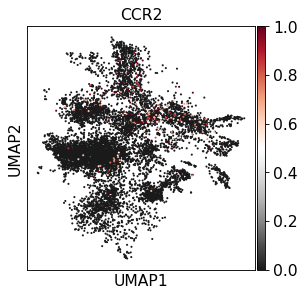

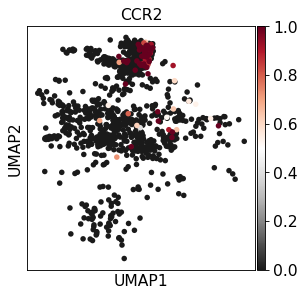

In [187]:
sc.pl.umap(adata3_lungN, color='CCR2', color_map='RdGy_r', vmax = 1,save = "Normal_CCR2.pdf")
sc.pl.umap(adata3_lungT, color='CCR2', color_map='RdGy_r',vmax = 1,save = "Tumor_CCR2.pdf")
sc.pl.umap(adata3_Tumor_IV, color='CCR2', color_map='RdGy_r',vmax = 1,save = "Advanced_Tumor_CCR2.pdf")

In [188]:
sc.get.obs_df(adata_lungT, keys=['MAFB']).to_csv('220813_stageI.tsv', sep='\t', index = True)
sc.get.obs_df(adata_Tumor_IV, keys=['MAFB']).to_csv('220813_stageIV.tsv', sep='\t', index = True)